----------------------------------------------
# PROBLEM-1:

The comp-activ database comprises of activity measures of computer systems. The data was gathered from Sun Sparcstation 20/712 with 128 Mbytes of memory, operating in a multi-user university department. User engaged in diverse tasks, such as internet access, file editing and CPU-intensive programs.

Being an aspiring data scientist, we aim to establish a linear equation for predicting 'usr'(the percentage of time CPUs operate in user mode). Your goal is to analyze various system attributes to understand their influence on the system's 'usr' mode.

--------------------------------------------------------------------------

### -> EDA and DATA-PREPROCESSING:
* First of all we will load the necessary python library files as per requirment in the below lines.

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split,GridSearchCV
import statsmodels.api as sm
from sklearn.metrics import mean_absolute_error, mean_squared_error
from statsmodels.stats.outliers_influence import variance_inflation_factor
from sklearn.linear_model import LogisticRegression
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.tree import DecisionTreeClassifier
from sklearn import metrics
from sklearn.metrics import roc_auc_score,roc_curve,classification_report,confusion_matrix,ConfusionMatrixDisplay
from sklearn import tree
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.linear_model import LinearRegression, Ridge, Lasso
from sklearn.preprocessing import scale
# To enable plotting graphs in Jupyter notebook
%matplotlib inline 

* Now, we will load the dataset named "compactiv.xlsx" and print the first and last five rows of the dataset as shown in below lines.

In [2]:
df_comp = pd.read_excel('compactiv.xlsx')

In [3]:
df_comp.head()

,lread,lwrite,scall,sread,swrite,fork,exec,rchar,wchar,pgout,...,pgscan,atch,pgin,ppgin,pflt,vflt,runqsz,freemem,freeswap,usr
0,1,0,2147,79,68,0.2,0.2,40671.0,53995.0,0.0,...,0.0,0.0,1.6,2.6,16.00,26.40,CPU_Bound,4670,1730946,95
1,0,0,170,18,21,0.2,0.2,448.0,8385.0,0.0,...,0.0,0.0,0.0,0.0,15.63,16.83,Not_CPU_Bound,7278,1869002,97
2,15,3,2162,159,119,2.0,2.4,NaN,31950.0,0.0,...,0.0,1.2,6.0,9.4,150.20,220.20,Not_CPU_Bound,702,1021237,87
3,0,0,160,12,16,0.2,0.2,NaN,8670.0,0.0,...,0.0,0.0,0.2,0.2,15.60,16.80,Not_CPU_Bound,7248,1863704,98
4,5,1,330,39,38,0.4,0.4,NaN,12185.0,0.0,...,0.0,0.0,1.0,1.2,37.80,47.60,Not_CPU_Bound,633,1760253,90


In [4]:
df_comp.tail()

,lread,lwrite,scall,sread,swrite,fork,exec,rchar,wchar,pgout,...,pgscan,atch,pgin,ppgin,pflt,vflt,runqsz,freemem,freeswap,usr
8187,16,12,3009,360,244,1.6,5.81,405250.0,85282.0,8.02,...,55.11,0.6,35.87,47.90,139.28,270.74,CPU_Bound,387,986647,80
8188,4,0,1596,170,146,2.4,1.80,89489.0,41764.0,3.80,...,0.20,0.8,3.80,4.40,122.40,212.60,Not_CPU_Bound,263,1055742,90
8189,16,5,3116,289,190,0.6,0.60,325948.0,52640.0,0.40,...,0.00,0.4,28.40,45.20,60.20,219.80,Not_CPU_Bound,400,969106,87
8190,32,45,5180,254,179,1.2,1.20,62571.0,29505.0,1.40,...,18.04,0.4,23.05,24.25,93.19,202.81,CPU_Bound,141,1022458,83
8191,2,0,985,55,46,1.6,4.80,111111.0,22256.0,0.00,...,0.00,0.2,3.40,6.20,91.80,110.00,CPU_Bound,659,1756514,94


* Now we will see the shape, data type, information and description of the data-set. After, we will check for any null or empty values in any columns and if found we will replace those empty values with the median of the respective variables. We will also check for any duplicate rows and if found we will drop those duplicate rows.

In [5]:
df_comp.shape

(8192, 22)

In [6]:
df_comp.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8192 entries, 0 to 8191
Data columns (total 22 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   lread     8192 non-null   int64  
 1   lwrite    8192 non-null   int64  
 2   scall     8192 non-null   int64  
 3   sread     8192 non-null   int64  
 4   swrite    8192 non-null   int64  
 5   fork      8192 non-null   float64
 6   exec      8192 non-null   float64
 7   rchar     8088 non-null   float64
 8   wchar     8177 non-null   float64
 9   pgout     8192 non-null   float64
 10  ppgout    8192 non-null   float64
 11  pgfree    8192 non-null   float64
 12  pgscan    8192 non-null   float64
 13  atch      8192 non-null   float64
 14  pgin      8192 non-null   float64
 15  ppgin     8192 non-null   float64
 16  pflt      8192 non-null   float64
 17  vflt      8192 non-null   float64
 18  runqsz    8192 non-null   object 
 19  freemem   8192 non-null   int64  
 20  freeswap  8192 non-null   int6

In [7]:
df_comp.isnull().sum()

lread         0
lwrite        0
scall         0
sread         0
swrite        0
fork          0
exec          0
rchar       104
wchar        15
pgout         0
ppgout        0
pgfree        0
pgscan        0
atch          0
pgin          0
ppgin         0
pflt          0
vflt          0
runqsz        0
freemem       0
freeswap      0
usr           0
dtype: int64

In [8]:
df_comp.rchar.fillna(df_comp.rchar.median(), inplace=True)
df_comp.wchar.fillna(df_comp.wchar.median(), inplace=True)

In [9]:
df_comp.isnull().sum()

lread       0
lwrite      0
scall       0
sread       0
swrite      0
fork        0
exec        0
rchar       0
wchar       0
pgout       0
ppgout      0
pgfree      0
pgscan      0
atch        0
pgin        0
ppgin       0
pflt        0
vflt        0
runqsz      0
freemem     0
freeswap    0
usr         0
dtype: int64

In [10]:
df_comp.duplicated().sum()

0

In [11]:
df_comp.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8192 entries, 0 to 8191
Data columns (total 22 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   lread     8192 non-null   int64  
 1   lwrite    8192 non-null   int64  
 2   scall     8192 non-null   int64  
 3   sread     8192 non-null   int64  
 4   swrite    8192 non-null   int64  
 5   fork      8192 non-null   float64
 6   exec      8192 non-null   float64
 7   rchar     8192 non-null   float64
 8   wchar     8192 non-null   float64
 9   pgout     8192 non-null   float64
 10  ppgout    8192 non-null   float64
 11  pgfree    8192 non-null   float64
 12  pgscan    8192 non-null   float64
 13  atch      8192 non-null   float64
 14  pgin      8192 non-null   float64
 15  ppgin     8192 non-null   float64
 16  pflt      8192 non-null   float64
 17  vflt      8192 non-null   float64
 18  runqsz    8192 non-null   object 
 19  freemem   8192 non-null   int64  
 20  freeswap  8192 non-null   int6

In [12]:
df_comp.describe().T

,count,mean,std,min,25%,50%,75%,max
lread,8192.0,1.955969e+01,53.353799,0.0,2.00,7.0,20.000,1845.00
lwrite,8192.0,1.310620e+01,29.891726,0.0,0.00,1.0,10.000,575.00
scall,8192.0,2.306318e+03,1633.617322,109.0,1012.00,2051.5,3317.250,12493.00
sread,8192.0,2.104800e+02,198.980146,6.0,86.00,166.0,279.000,5318.00
swrite,8192.0,1.500582e+02,160.478980,7.0,63.00,117.0,185.000,5456.00
fork,8192.0,1.884554e+00,2.479493,0.0,0.40,0.8,2.200,20.12
exec,8192.0,2.791998e+00,5.212456,0.0,0.20,1.2,2.800,59.56
rchar,8192.0,1.964728e+05,238446.012054,278.0,34860.50,125473.5,265394.750,2526649.00
wchar,8192.0,9.581275e+04,140728.464118,1498.0,22977.75,46619.0,106037.000,1801623.00
pgout,8192.0,2.285317e+00,5.307038,0.0,0.00,0.0,2.400,81.44


In [13]:
df_comp.runqsz.value_counts()

runqsz
Not_CPU_Bound    4331
CPU_Bound        3861
Name: count, dtype: int64

* For Univatiate and Bivariate analysis we will split our dataset into two parts one for numerical variables and other one for categorical variables.

In [14]:
dfnum = df_comp.drop('runqsz',axis=1)
dfcat = df_comp.pop('runqsz')

### UNIVARIATE ANALYSIS

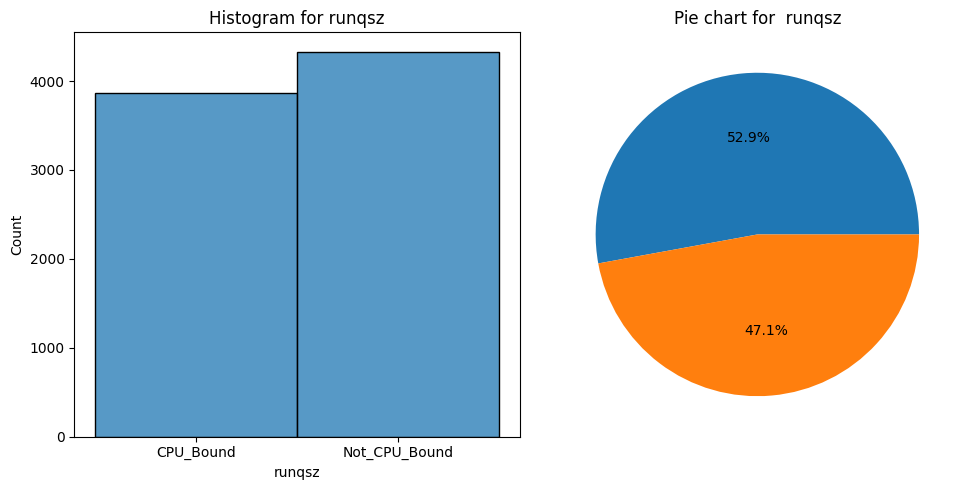

In [15]:
plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.title('Histogram for runqsz')
sns.histplot(dfcat)
plt.subplot(1, 2, 2)
plt.title('Pie chart for  runqsz')
plt.pie(dfcat.value_counts(), autopct='%1.1f%%')
plt.tight_layout()
plt.show()

-> Now, will create a boxplot and histogram for each and numerical variables and do outliers treatment if required.

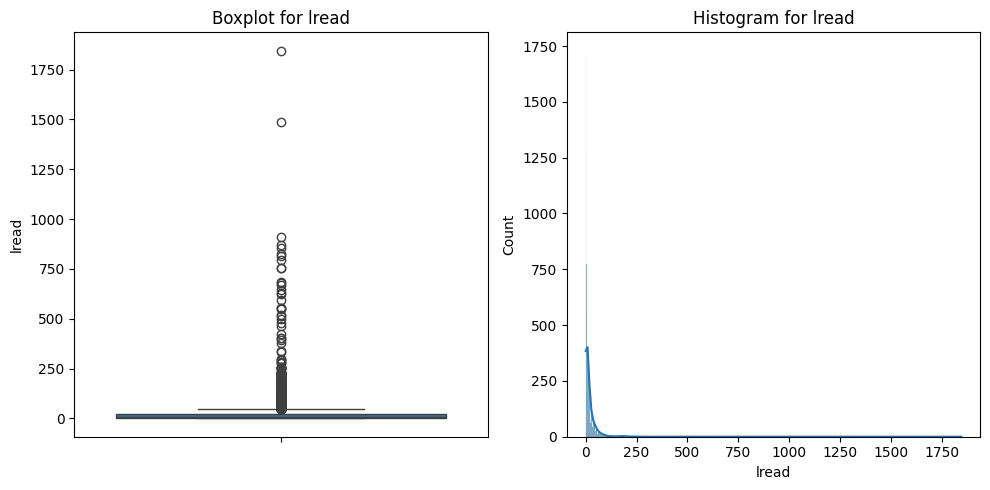

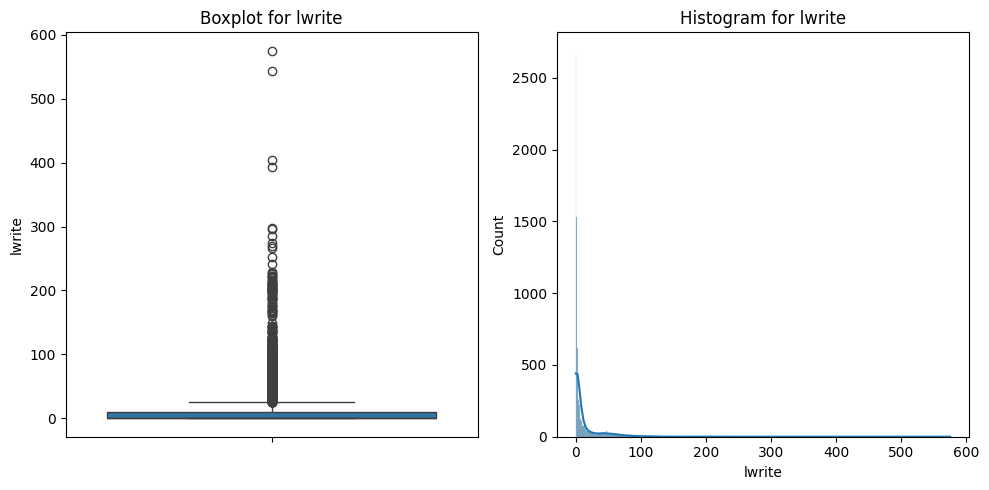

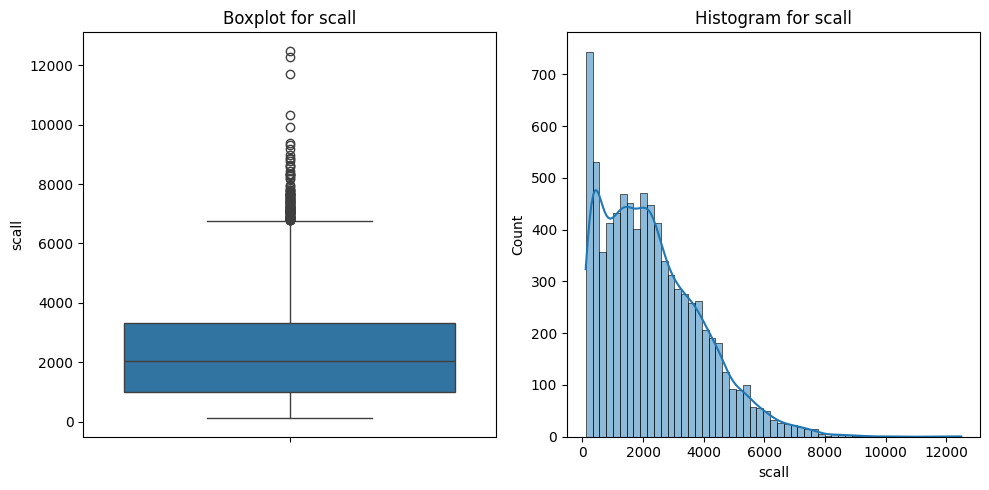

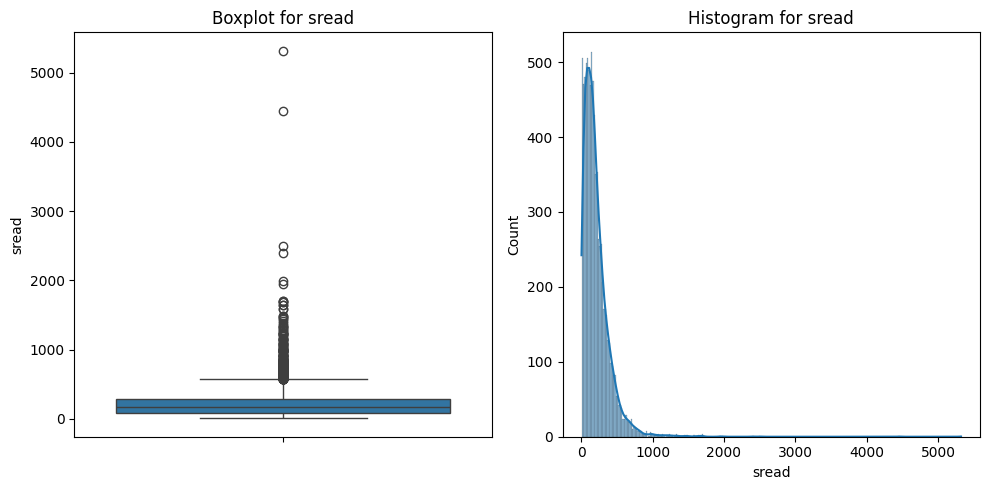

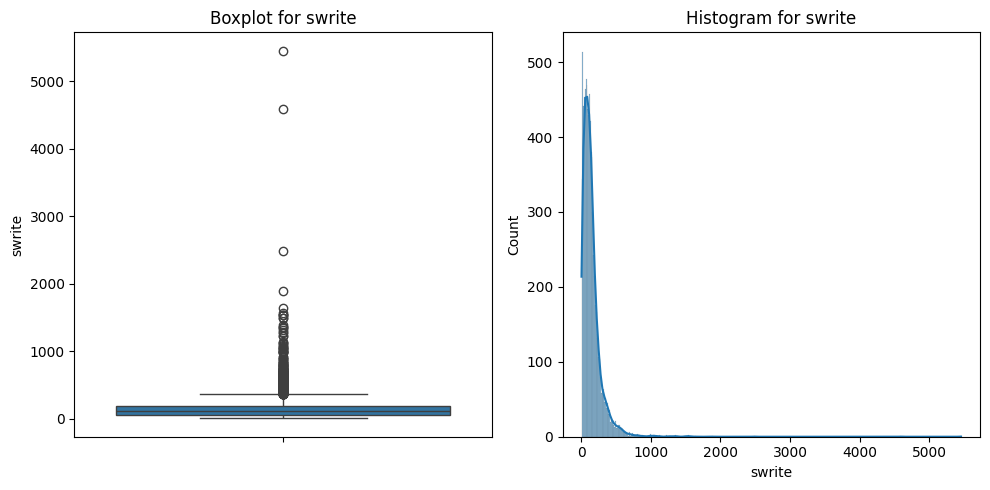

...

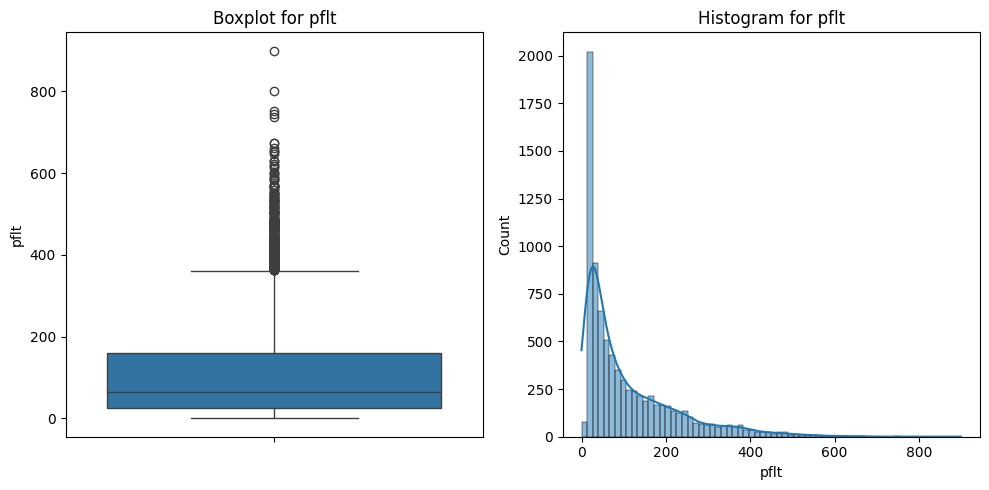

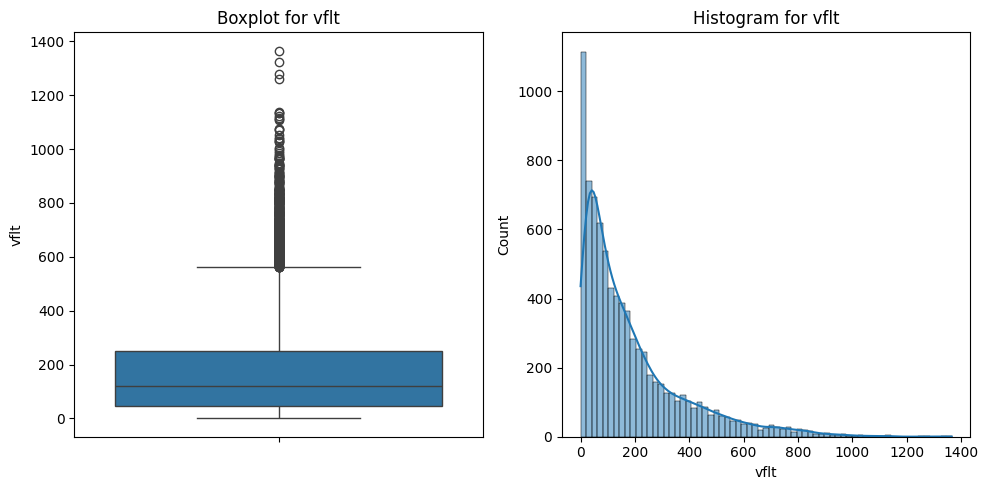

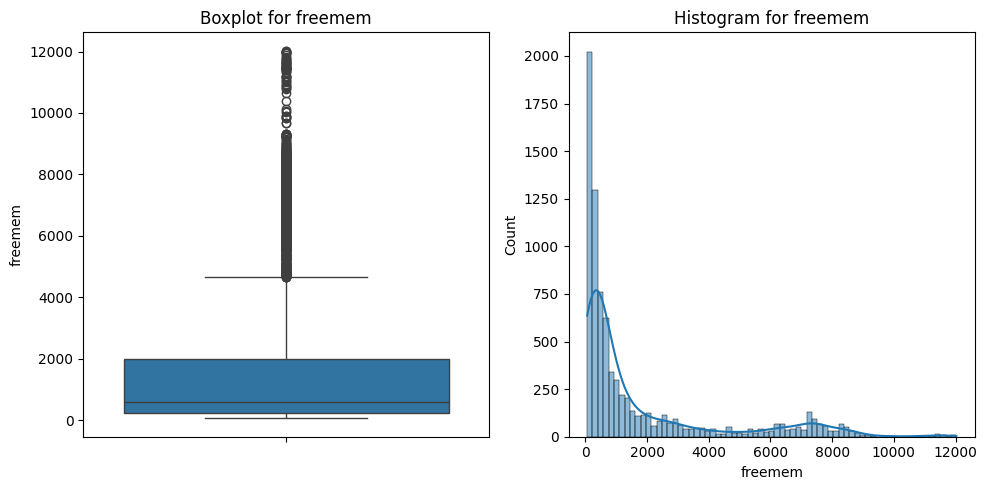

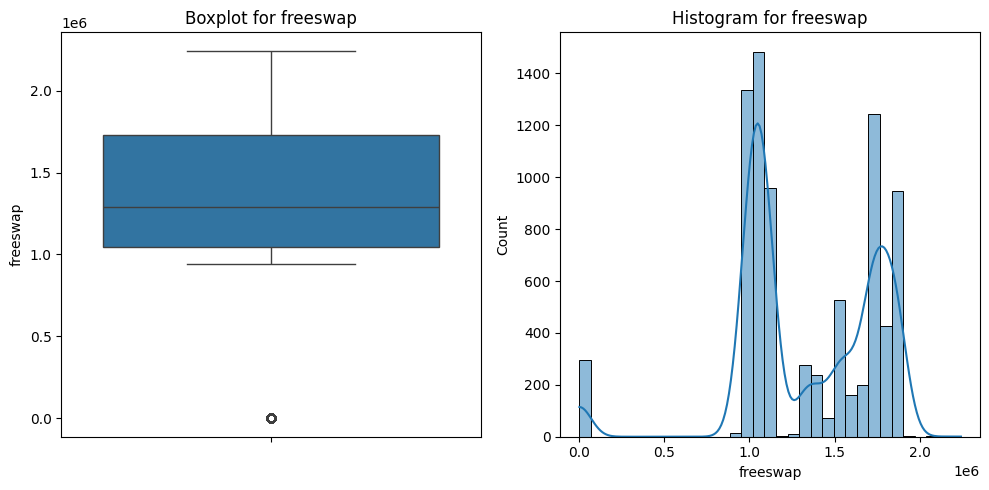

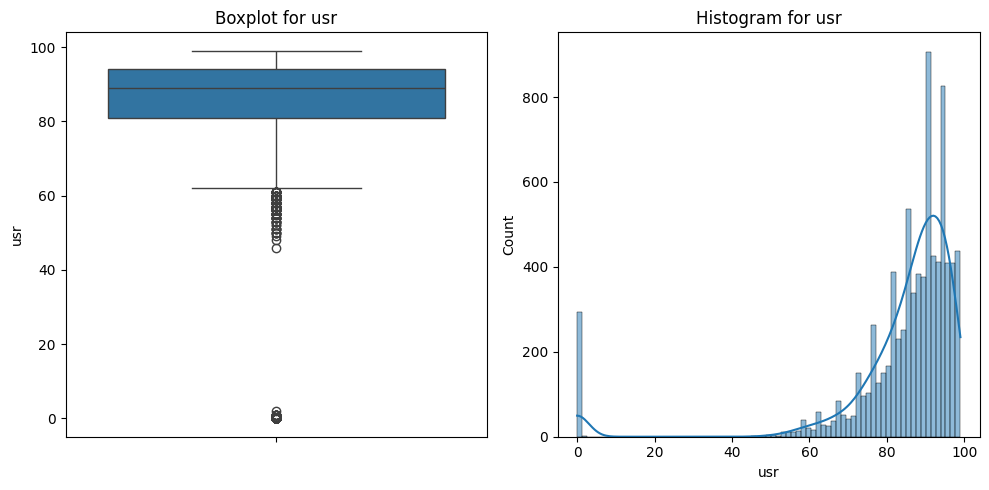

In [16]:
list_columns = dfnum.columns
for i in range(len(list_columns)):
    plt.figure(figsize=(10, 5))  # Set the figure size for better visibility
    plt.subplot(1, 2, 1)  # Define the first subplot for the boxplot
    plt.title('Boxplot for {}'.format(list_columns[i]))
    sns.boxplot(y=dfnum[list_columns[i]])  # Use 'y' to specify the vertical boxplot

    plt.subplot(1, 2, 2)  # Define the second subplot for the histogram
    plt.title('Histogram for {}'.format(list_columns[i]))
    sns.histplot(dfnum[list_columns[i]], kde=True)  # Added KDE (Kernel Density Estimate) for smoothness

    plt.tight_layout()  # Adjust subplots to fit into the figure area.
    plt.show()

In [17]:
for column in dfnum.select_dtypes(include=np.number).columns:
    
    q1 = dfnum[column].quantile(0.25)
    q3 = dfnum[column].quantile(0.75)
    IQR = q3 - q1
    
    uplim = q3 + (1.5 * IQR)
    lowlim = q1 - (1.5 * IQR)
    
    dfnum[column] = np.where(dfnum[column] < lowlim, lowlim, dfnum[column])
    dfnum[column] = np.where(dfnum[column] > uplim, uplim, dfnum[column])

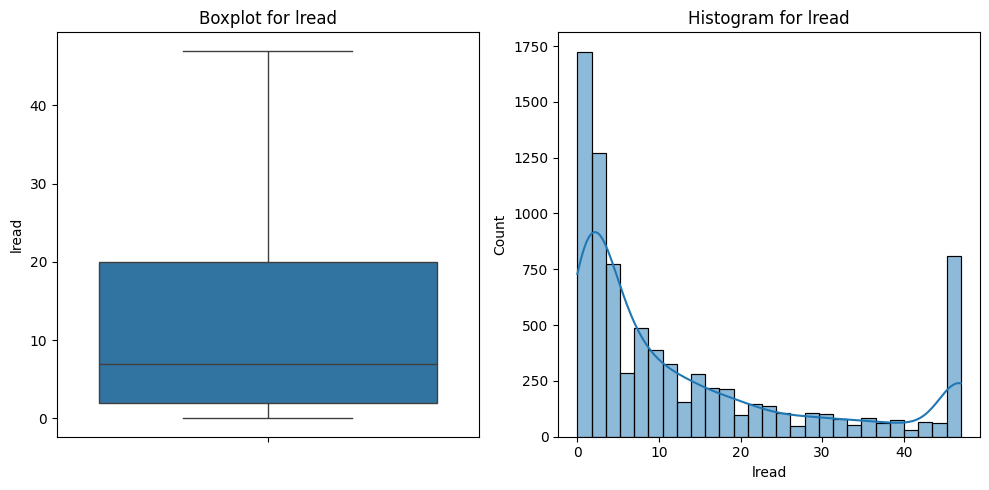

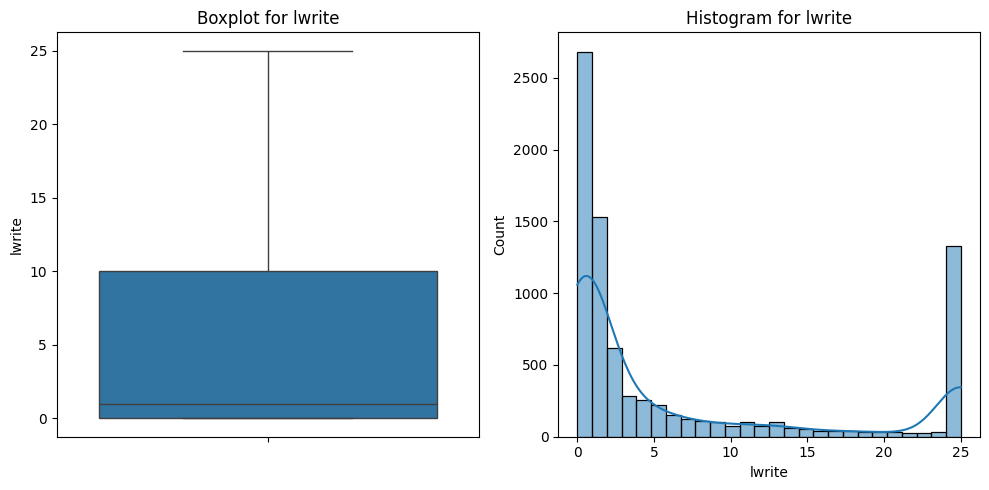

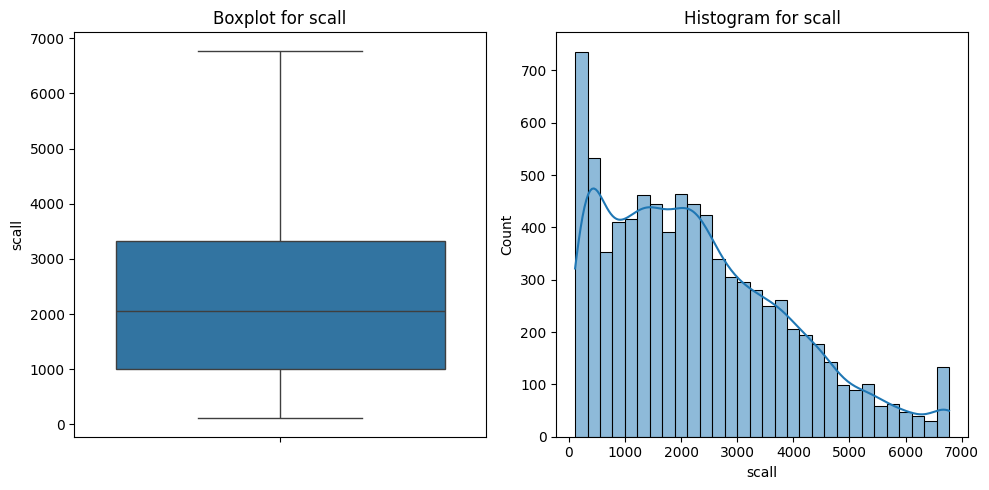

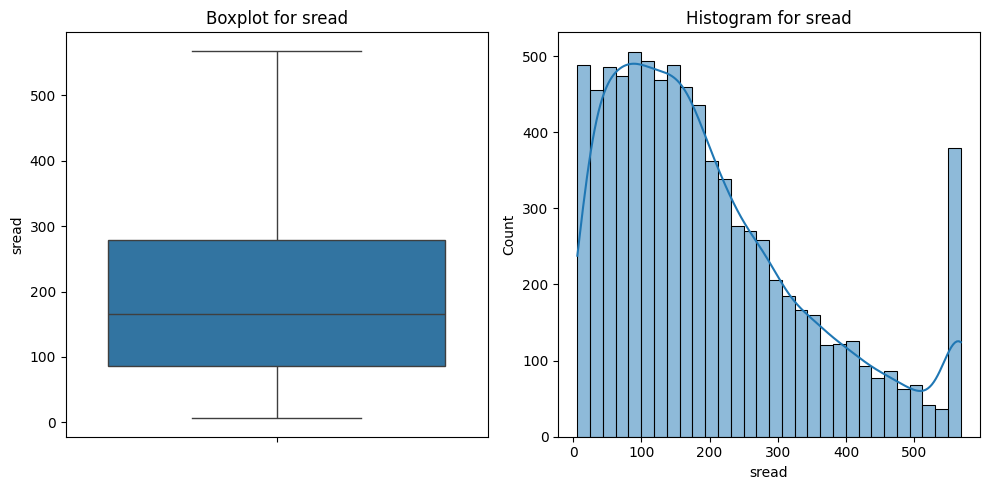

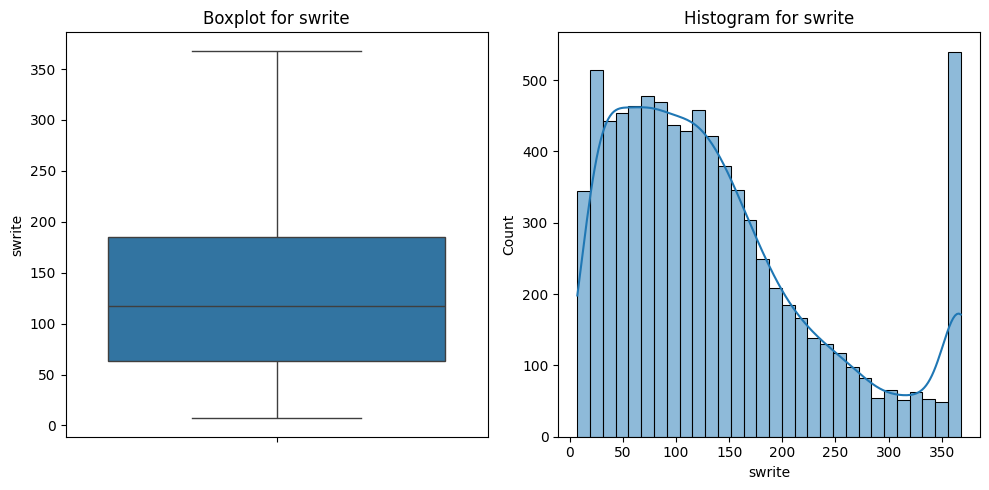

...

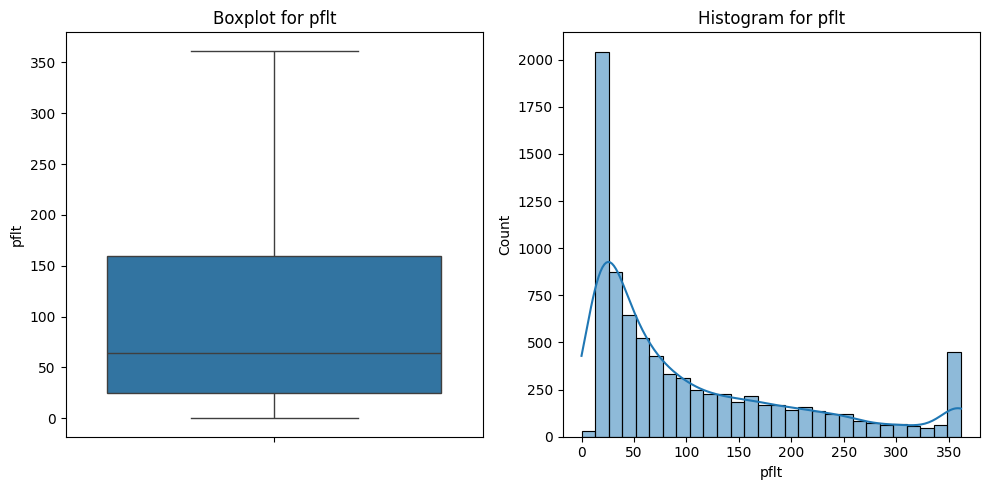

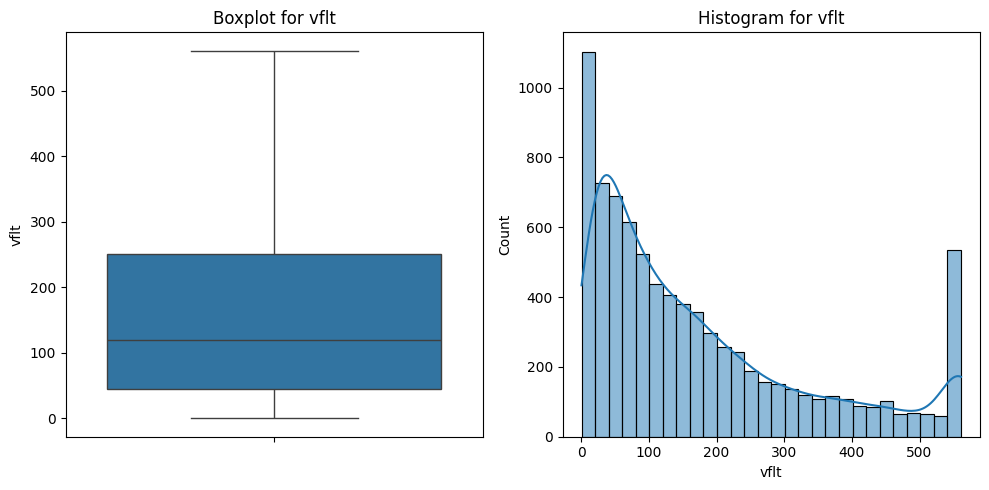

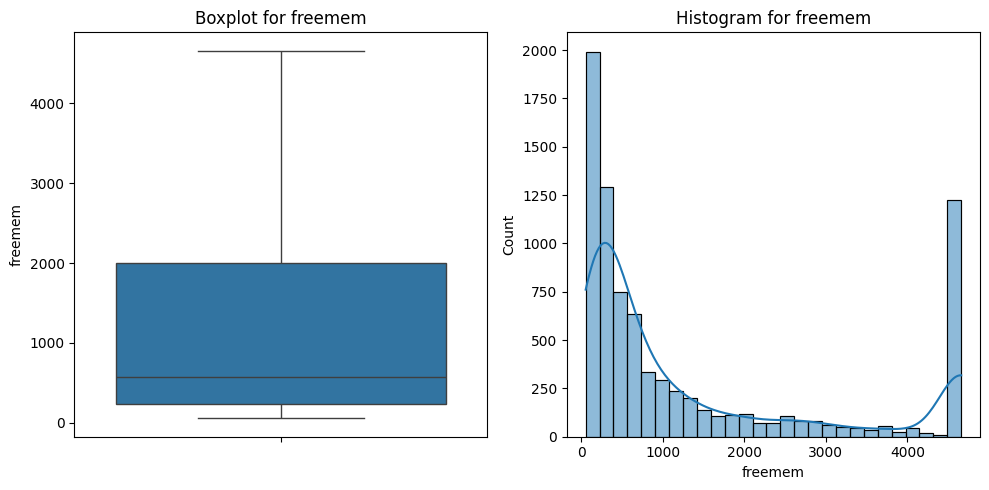

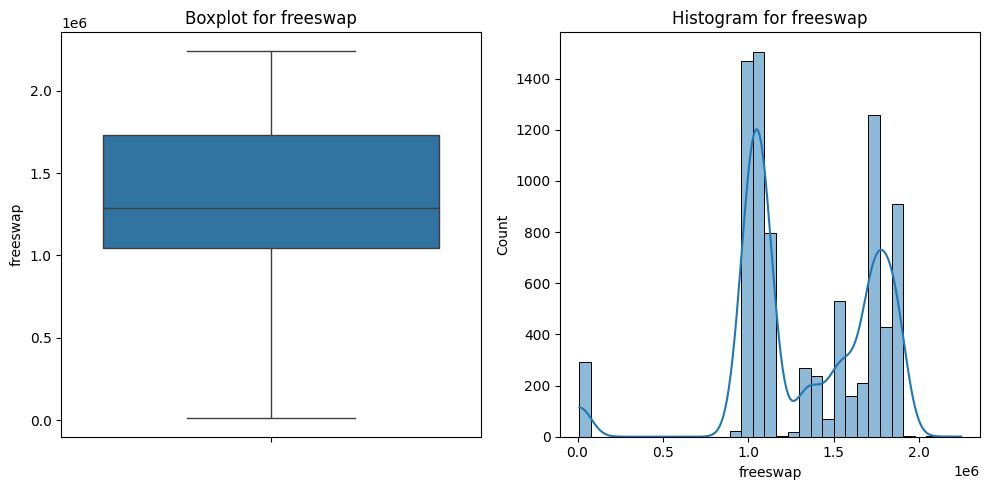

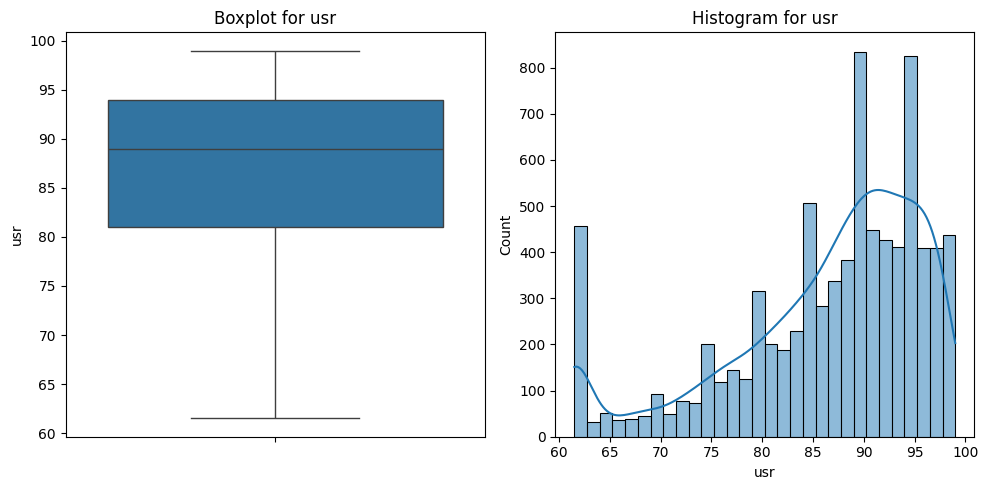

In [18]:
list_columns = dfnum.columns
for i in range(len(list_columns)):
    plt.figure(figsize=(10, 5))  # Set the figure size for better visibility
    plt.subplot(1, 2, 1)  # Define the first subplot for the boxplot
    plt.title('Boxplot for {}'.format(list_columns[i]))
    sns.boxplot(y=dfnum[list_columns[i]])  # Use 'y' to specify the vertical boxplot

    plt.subplot(1, 2, 2)  # Define the second subplot for the histogram
    plt.title('Histogram for {}'.format(list_columns[i]))
    sns.histplot(dfnum[list_columns[i]], kde=True)  # Added KDE (Kernel Density Estimate) for smoothness

    plt.tight_layout()  # Adjust subplots to fit into the figure area.
    plt.show()

* From the above we can say that the variable "pgscan" has zero contribution to the data set we can also see wusing describe function on it and we can drop that variable from our dataset.

In [19]:
dfnum.pgscan.describe().T

count    8192.0
mean        0.0
std         0.0
min         0.0
25%         0.0
50%         0.0
75%         0.0
max         0.0
Name: pgscan, dtype: float64

In [20]:
dfnum.drop('pgscan',axis = 1,inplace = True)

In [21]:
dfnum.tail()

,lread,lwrite,scall,sread,swrite,fork,exec,rchar,wchar,pgout,ppgout,pgfree,atch,pgin,ppgin,pflt,vflt,freemem,freeswap,usr
8187,16.0,12.0,3009.0,360.0,244.0,1.6,5.81,405250.0,85282.0,6.0,10.5,12.5,0.6,23.5125,33.60,139.28,270.74,387.0,986647.0,80.0
8188,4.0,0.0,1596.0,170.0,146.0,2.4,1.80,89489.0,41764.0,3.8,4.8,4.8,0.8,3.8000,4.40,122.40,212.60,263.0,1055742.0,90.0
8189,16.0,5.0,3116.0,289.0,190.0,0.6,0.60,325948.0,52640.0,0.4,0.6,0.6,0.4,23.5125,33.60,60.20,219.80,400.0,969106.0,87.0
8190,32.0,25.0,5180.0,254.0,179.0,1.2,1.20,62571.0,29505.0,1.4,1.6,12.5,0.4,23.0500,24.25,93.19,202.81,141.0,1022458.0,83.0
8191,2.0,0.0,985.0,55.0,46.0,1.6,4.80,111111.0,22256.0,0.0,0.0,0.0,0.2,3.4000,6.20,91.80,110.00,659.0,1756514.0,94.0


### MULTIVARIATE ANALYSIS

<Axes: title={'center': 'lread vs usr Barplot'}, xlabel='usr', ylabel='lread'>

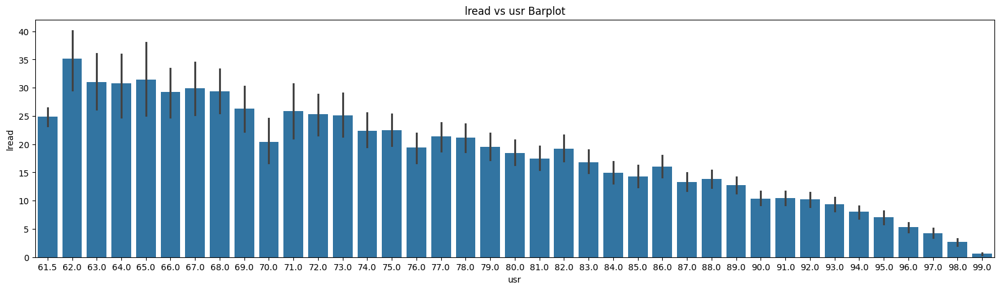

In [22]:
plt.figure(figsize=(20,5))
plt.title('lread vs usr Barplot')
sns.barplot(data=dfnum,y='lread',x='usr')

<Axes: title={'center': 'lwrite vs usr Barplot'}, xlabel='usr', ylabel='lwrite'>

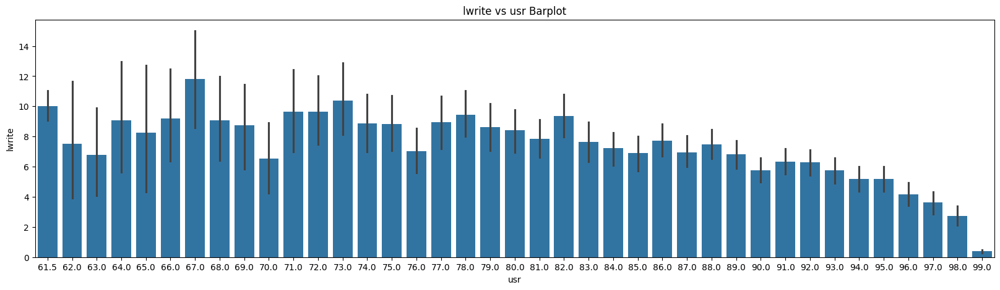

In [23]:
plt.figure(figsize=(20,5))
plt.title('lwrite vs usr Barplot')
sns.barplot(data=dfnum,y='lwrite',x='usr')

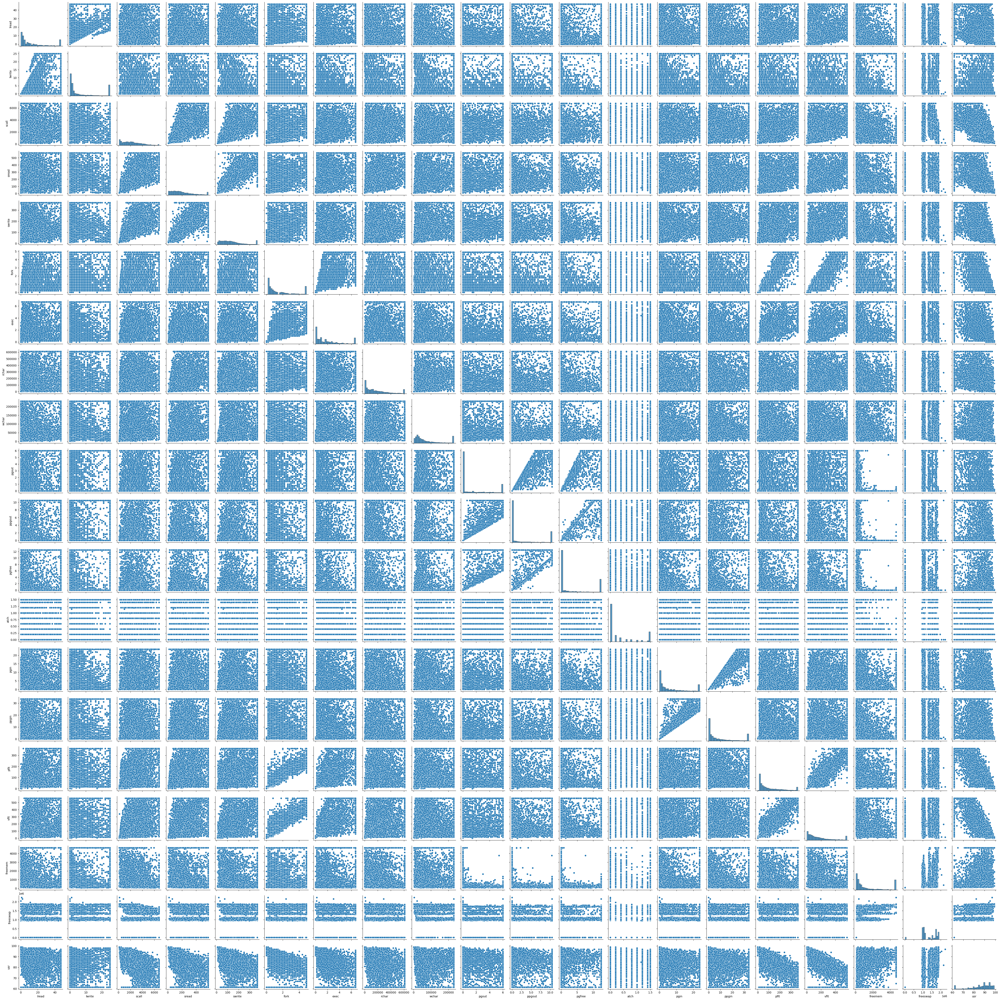

In [24]:
sns.pairplot(dfnum)
plt.savefig("pairplot1.jpg")

In [25]:
num_corr = dfnum.corr()
num_corr

,lread,lwrite,scall,sread,swrite,fork,exec,rchar,wchar,pgout,ppgout,pgfree,atch,pgin,ppgin,pflt,vflt,freemem,freeswap,usr
lread,1.000000,0.834674,0.333572,0.326032,0.306542,0.365676,0.364062,0.255544,0.174410,0.208258,0.219798,0.214400,0.230628,0.283252,0.290564,0.375250,0.421079,-0.201369,-0.243903,-0.438163
lwrite,0.834674,1.000000,0.140213,0.148028,0.132097,0.093166,0.121778,0.117504,0.132595,0.090726,0.089149,0.082519,0.126769,0.113368,0.118388,0.102631,0.135243,-0.099558,-0.149630,-0.185695
scall,0.333572,0.140213,1.000000,0.763001,0.742206,0.474491,0.440010,0.386875,0.331933,0.297487,0.305507,0.300612,0.306359,0.335380,0.325487,0.485361,0.548081,-0.388969,-0.357864,-0.618932
sread,0.326032,0.148028,0.763001,1.000000,0.876652,0.528047,0.369723,0.576127,0.415059,0.301658,0.315648,0.311863,0.292044,0.346654,0.344586,0.529364,0.597892,-0.349887,-0.369897,-0.638072
swrite,0.306542,0.132097,0.742206,0.876652,1.000000,0.519148,0.313323,0.419759,0.430126,0.274708,0.284982,0.280082,0.264283,0.307420,0.302481,0.505560,0.563163,-0.350318,-0.336869,-0.598098
fork,0.365676,0.093166,0.474491,0.528047,0.519148,1.000000,0.774268,0.370995,0.122990,0.197047,0.214192,0.216166,0.201768,0.247715,0.236216,0.939125,0.932579,-0.136045,-0.133135,-0.673513
exec,0.364062,0.121778,0.440010,0.369723,0.313323,0.774268,1.000000,0.324990,0.124145,0.230712,0.248680,0.250468,0.252416,0.299591,0.288017,0.758255,0.763429,-0.191919,-0.184268,-0.609368
rchar,0.255544,0.117504,0.386875,0.576127,0.419759,0.370995,0.324990,1.000000,0.486317,0.250881,0.267983,0.261728,0.265281,0.369470,0.390376,0.381489,0.438870,-0.165552,-0.230327,-0.507561
wchar,0.174410,0.132595,0.331933,0.415059,0.430126,0.122990,0.124145,0.486317,1.000000,0.195926,0.204542,0.187786,0.160142,0.250258,0.260535,0.125757,0.157922,-0.146838,-0.175309,-0.317330
pgout,0.208258,0.090726,0.297487,0.301658,0.274708,0.197047,0.230712,0.250881,0.195926,1.000000,0.950418,0.909151,0.642940,0.437916,0.448769,0.206128,0.299740,-0.469831,-0.348040,-0.381960


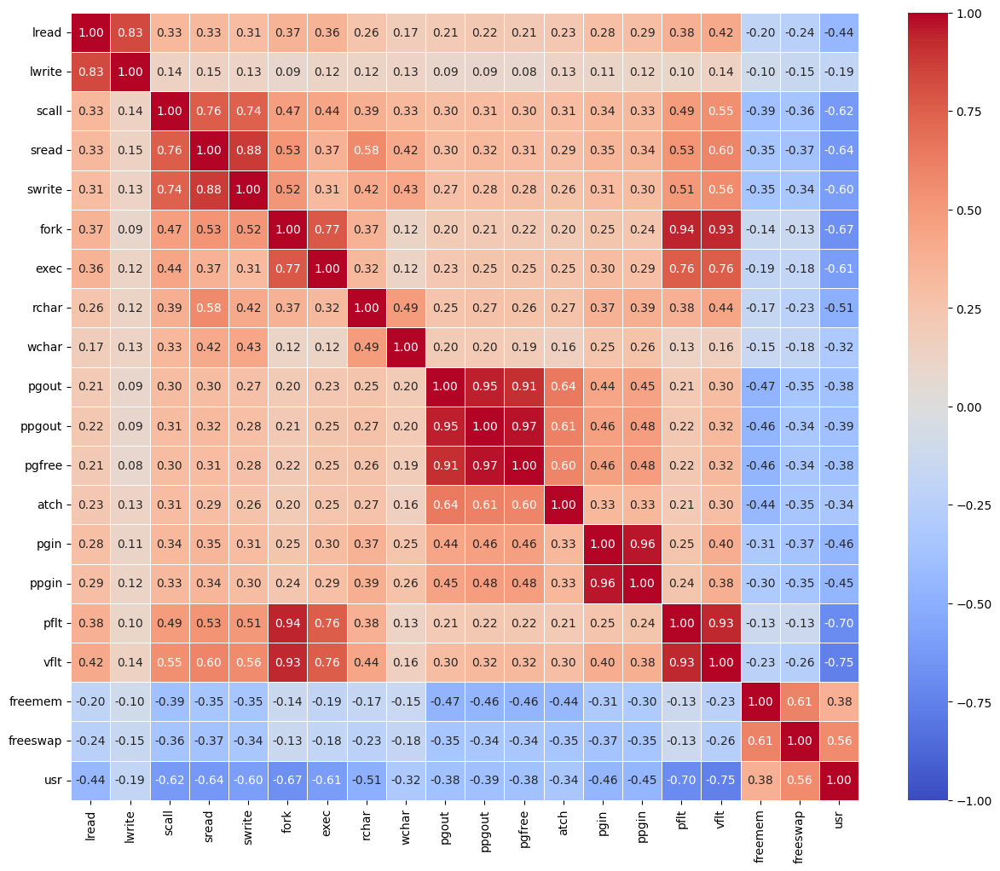

In [26]:
plt.figure(figsize=(15, 12))
sns.heatmap(num_corr, annot=True, cmap="coolwarm", fmt=".2f", linewidths=.5, square=True,annot_kws={"size": 10},vmin=-1,vmax=1)
plt.savefig("heatmap1.jpg")
plt.show()

* Now, we will combine the two sub-dataset into one and do encoding on the categorical variable named "runqsz" and convert it into a numerical data type.

In [27]:
comp_df = pd.concat([dfnum,dfcat],axis=1)
comp_df.head()

,lread,lwrite,scall,sread,swrite,fork,exec,rchar,wchar,pgout,...,pgfree,atch,pgin,ppgin,pflt,vflt,freemem,freeswap,usr,runqsz
0,1.0,0.0,2147.0,79.0,68.0,0.2,0.2,40671.0,53995.0,0.0,...,0.0,0.0,1.6,2.6,16.00,26.40,4659.125,1730946.0,95.0,CPU_Bound
1,0.0,0.0,170.0,18.0,21.0,0.2,0.2,448.0,8385.0,0.0,...,0.0,0.0,0.0,0.0,15.63,16.83,4659.125,1869002.0,97.0,Not_CPU_Bound
2,15.0,3.0,2162.0,159.0,119.0,2.0,2.4,125473.5,31950.0,0.0,...,0.0,1.2,6.0,9.4,150.20,220.20,702.000,1021237.0,87.0,Not_CPU_Bound
3,0.0,0.0,160.0,12.0,16.0,0.2,0.2,125473.5,8670.0,0.0,...,0.0,0.0,0.2,0.2,15.60,16.80,4659.125,1863704.0,98.0,Not_CPU_Bound
4,5.0,1.0,330.0,39.0,38.0,0.4,0.4,125473.5,12185.0,0.0,...,0.0,0.0,1.0,1.2,37.80,47.60,633.000,1760253.0,90.0,Not_CPU_Bound


In [28]:
comp = pd.get_dummies(comp_df,columns=['runqsz'],drop_first=True)
comp.head()

,lread,lwrite,scall,sread,swrite,fork,exec,rchar,wchar,pgout,...,pgfree,atch,pgin,ppgin,pflt,vflt,freemem,freeswap,usr,runqsz_Not_CPU_Bound
0,1.0,0.0,2147.0,79.0,68.0,0.2,0.2,40671.0,53995.0,0.0,...,0.0,0.0,1.6,2.6,16.00,26.40,4659.125,1730946.0,95.0,False
1,0.0,0.0,170.0,18.0,21.0,0.2,0.2,448.0,8385.0,0.0,...,0.0,0.0,0.0,0.0,15.63,16.83,4659.125,1869002.0,97.0,True
2,15.0,3.0,2162.0,159.0,119.0,2.0,2.4,125473.5,31950.0,0.0,...,0.0,1.2,6.0,9.4,150.20,220.20,702.000,1021237.0,87.0,True
3,0.0,0.0,160.0,12.0,16.0,0.2,0.2,125473.5,8670.0,0.0,...,0.0,0.0,0.2,0.2,15.60,16.80,4659.125,1863704.0,98.0,True
4,5.0,1.0,330.0,39.0,38.0,0.4,0.4,125473.5,12185.0,0.0,...,0.0,0.0,1.0,1.2,37.80,47.60,633.000,1760253.0,90.0,True


In [29]:
comp['runqsz_Not_CPU_Bound'] = comp['runqsz_Not_CPU_Bound'].astype('int64')
comp.head()

,lread,lwrite,scall,sread,swrite,fork,exec,rchar,wchar,pgout,...,pgfree,atch,pgin,ppgin,pflt,vflt,freemem,freeswap,usr,runqsz_Not_CPU_Bound
0,1.0,0.0,2147.0,79.0,68.0,0.2,0.2,40671.0,53995.0,0.0,...,0.0,0.0,1.6,2.6,16.00,26.40,4659.125,1730946.0,95.0,0
1,0.0,0.0,170.0,18.0,21.0,0.2,0.2,448.0,8385.0,0.0,...,0.0,0.0,0.0,0.0,15.63,16.83,4659.125,1869002.0,97.0,1
2,15.0,3.0,2162.0,159.0,119.0,2.0,2.4,125473.5,31950.0,0.0,...,0.0,1.2,6.0,9.4,150.20,220.20,702.000,1021237.0,87.0,1
3,0.0,0.0,160.0,12.0,16.0,0.2,0.2,125473.5,8670.0,0.0,...,0.0,0.0,0.2,0.2,15.60,16.80,4659.125,1863704.0,98.0,1
4,5.0,1.0,330.0,39.0,38.0,0.4,0.4,125473.5,12185.0,0.0,...,0.0,0.0,1.0,1.2,37.80,47.60,633.000,1760253.0,90.0,1


* From the EDA we can see that in many variables/columns have zero values.

C:\Users\Harsh Patel\AppData\Local\Temp\ipykernel_16024\3926974251.py:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  plots=sns.barplot(x=zero_counts.index, y=zero_counts.values, palette='viridis')


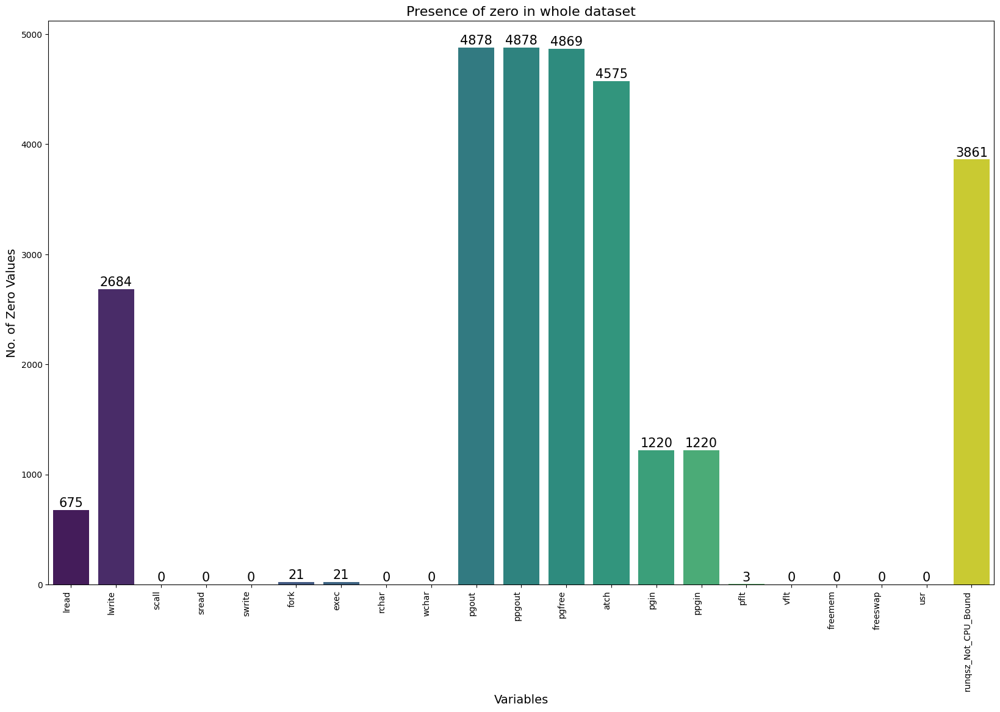

In [30]:
zero_counts = (comp == 0).sum()

plt.figure(figsize=(20, 12))
plots=sns.barplot(x=zero_counts.index, y=zero_counts.values, palette='viridis')

for bar in plots.patches:
   

    plots.annotate(f'{int(bar.get_height())}', 
                   (bar.get_x() + bar.get_width() / 2, bar.get_height()), 
                   ha='center', va='center',
                   size=15, xytext=(0, 8),
                   textcoords='offset points')
plt.xlabel('Variables', fontsize=14)
plt.ylabel('No. of Zero Values', fontsize=14)
plt.title("Presence of zero in whole dataset", fontsize=16)
#comp["scall"] = np.square(comp["scall"])
plt.xticks(rotation=90, ha='right')  # Rotate x-axis labels for better readability
#plt.savefig("zeropresence.jpg")
plt.show()

In [31]:
zero_percentage = round((comp == 0).mean() * 100, 2)
print(zero_percentage)

lread                    8.24
lwrite                  32.76
scall                    0.00
sread                    0.00
swrite                   0.00
fork                     0.26
exec                     0.26
rchar                    0.00
wchar                    0.00
pgout                   59.55
ppgout                  59.55
pgfree                  59.44
atch                    55.85
pgin                    14.89
ppgin                   14.89
pflt                     0.04
vflt                     0.00
freemem                  0.00
freeswap                 0.00
usr                      0.00
runqsz_Not_CPU_Bound    47.13
dtype: float64


In [32]:
New_comp = comp.drop(['pgout','ppgout','pgfree','atch'], axis=1)
New_comp.head()

,lread,lwrite,scall,sread,swrite,fork,exec,rchar,wchar,pgin,ppgin,pflt,vflt,freemem,freeswap,usr,runqsz_Not_CPU_Bound
0,1.0,0.0,2147.0,79.0,68.0,0.2,0.2,40671.0,53995.0,1.6,2.6,16.00,26.40,4659.125,1730946.0,95.0,0
1,0.0,0.0,170.0,18.0,21.0,0.2,0.2,448.0,8385.0,0.0,0.0,15.63,16.83,4659.125,1869002.0,97.0,1
2,15.0,3.0,2162.0,159.0,119.0,2.0,2.4,125473.5,31950.0,6.0,9.4,150.20,220.20,702.000,1021237.0,87.0,1
3,0.0,0.0,160.0,12.0,16.0,0.2,0.2,125473.5,8670.0,0.2,0.2,15.60,16.80,4659.125,1863704.0,98.0,1
4,5.0,1.0,330.0,39.0,38.0,0.4,0.4,125473.5,12185.0,1.0,1.2,37.80,47.60,633.000,1760253.0,90.0,1


### TRAIN_TEST SPLIT

In [33]:
X= New_comp.drop('usr', axis = 1)


In [34]:
y= New_comp['usr']

In [35]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.30, random_state=1)

In [36]:
X_train = sm.add_constant(X_train)
X_test = sm.add_constant(X_test)

### Linear Regression using Statsmodels

In [37]:
olsmod = sm.OLS(y_train, X_train)
ols = olsmod.fit()
print(ols.summary())

                            OLS Regression Results                            
Dep. Variable:                    usr   R-squared:                       0.793
Model:                            OLS   Adj. R-squared:                  0.793
Method:                 Least Squares   F-statistic:                     1371.
Date:                Sun, 09 Jun 2024   Prob (F-statistic):               0.00
Time:                        17:07:12   Log-Likelihood:                -16697.
No. Observations:                5734   AIC:                         3.343e+04
Df Residuals:                    5717   BIC:                         3.354e+04
Df Model:                          16                                         
Covariance Type:            nonrobust                                         
                           coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                   84.0958 


**R-squared Value:**
An R-squared of 79.6% is quite robust, suggesting that your model has a strong ability to predict the outcome variable based on the predictors you've chosen. It's like saying that nearly 80% of the dance moves on the floor are in sync with the music you're playing.

**Coefficients:**
The coefficients in your regression model are like the ingredients in a recipe. Each one contributes a certain flavor to the dish. A positive sign means adding more of that ingredient makes the dish sweeter (increases the response variable), while a negative sign means it makes the dish more bitter (decreases the response variable). For instance, adding one more 'lread' reduces the 'usr' by 0.0635, indicating a slight inverse relationship.

**Multicollinearity:**
Imagine multicollinearity as a team of rowers in a boat. If they start rowing in sync, the boat moves smoothly (low multicollinearity). But if they row at different rhythms or the same rhythm but too closely (high multicollinearity), it can throw off the boat's balance, making it hard to see each rower's individual effort.

**P-values:**
P-values act as a filter for the significance of your predictors. If a p-value is above 0.05, it's like a warning light indicating that the predictor might not have a significant solo performance in predicting the outcome.

**Detecting Multicollinearity with VIF:**
The Variance Inflation Factor (VIF) is like a magnifying glass for examining the relationships between predictors. A VIF of 1 means each predictor is doing its own solo act, while a VIF higher than 5 starts to show a group performance, and a VIF of 10 or more means the predictors are performing a full ensemble, making it hard to distinguish individualhe perfect taste.

In [38]:
vif_series1 = pd.Series(
    [variance_inflation_factor(X_train.values, i) for i in range(X_train.shape[1])],
    index=X_train.columns,
)
print("VIF values: \n\n{}\n".format(vif_series1))

VIF values: 

const                   28.609091
lread                    5.347108
lwrite                   4.323143
scall                    2.952397
sread                    6.411386
swrite                   5.594077
fork                    12.946409
exec                     3.226176
rchar                    2.112262
wchar                    1.567794
pgin                    13.746882
ppgin                   13.652056
pflt                    11.962431
vflt                    15.634398
freemem                  1.725026
freeswap                 1.833247
runqsz_Not_CPU_Bound     1.141561
dtype: float64



In [39]:
X_train2 = X_train.drop(['lread'], axis=1)
olsmod_1 = sm.OLS(y_train, X_train2)
olsres_1 = olsmod_1.fit()
print(
    "R-squared:",
    np.round(olsres_1.rsquared, 3),
    "\nAdjusted R-squared:",
    np.round(olsres_1.rsquared_adj, 3),
)

R-squared: 0.791 
Adjusted R-squared: 0.791


In [40]:
X_train3 = X_train.drop(['lwrite'], axis=1)
olsmod_2 = sm.OLS(y_train, X_train3)
olsres_2 = olsmod_2.fit()
print(
    "R-squared:",
    np.round(olsres_2.rsquared, 3),
    "\nAdjusted R-squared:",
    np.round(olsres_2.rsquared_adj, 3),
)

R-squared: 0.793 
Adjusted R-squared: 0.792


In [41]:
X_train4 = X_train.drop(['scall'], axis=1)
olsmod_3 = sm.OLS(y_train, X_train4)
olsres_3 = olsmod_1.fit()
print(
    "R-squared:",
    np.round(olsres_3.rsquared, 3),
    "\nAdjusted R-squared:",
    np.round(olsres_3.rsquared_adj, 3),
)

R-squared: 0.791 
Adjusted R-squared: 0.791


In [42]:
X_train5 = X_train.drop(['sread'], axis=1)
olsmod_4 = sm.OLS(y_train, X_train5)
olsres_4 = olsmod_4.fit()
print(
    "R-squared:",
    np.round(olsres_4.rsquared, 3),
    "\nAdjusted R-squared:",
    np.round(olsres_4.rsquared_adj, 3),
)

R-squared: 0.793 
Adjusted R-squared: 0.793


In [43]:
X_train.drop(['sread'], axis = 1, inplace = True)

In [44]:
olsmod_f1 = sm.OLS(y_train, X_train)
ols_f1 = olsmod_f1.fit()
print(ols_f1.summary())

                            OLS Regression Results                            
Dep. Variable:                    usr   R-squared:                       0.793
Model:                            OLS   Adj. R-squared:                  0.793
Method:                 Least Squares   F-statistic:                     1463.
Date:                Sun, 09 Jun 2024   Prob (F-statistic):               0.00
Time:                        17:07:12   Log-Likelihood:                -16697.
No. Observations:                5734   AIC:                         3.343e+04
Df Residuals:                    5718   BIC:                         3.353e+04
Df Model:                          15                                         
Covariance Type:            nonrobust                                         
                           coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                   84.0963 

In [45]:
vif_series2 = pd.Series(
    [variance_inflation_factor(X_train.values, i) for i in range(X_train.shape[1])],
    index=X_train.columns,
)
print("VIF values: \n\n{}\n".format(vif_series2))

VIF values: 

const                   28.568057
lread                    5.338104
lwrite                   4.314089
scall                    2.708324
swrite                   3.208427
fork                    12.913012
exec                     3.219504
rchar                    1.713648
wchar                    1.557654
pgin                    13.743915
ppgin                   13.652006
pflt                    11.961062
vflt                    15.522793
freemem                  1.724654
freeswap                 1.824264
runqsz_Not_CPU_Bound     1.141557
dtype: float64



In [46]:
X_train6 = X_train.drop(['swrite'], axis=1)
olsmod_5 = sm.OLS(y_train, X_train6)
olsres_5 = olsmod_5.fit()
print(
    "R-squared:",
    np.round(olsres_5.rsquared, 3),
    "\nAdjusted R-squared:",
    np.round(olsres_5.rsquared_adj, 3),
)

R-squared: 0.792 
Adjusted R-squared: 0.792


In [47]:
X_train7 = X_train.drop(['fork'], axis=1)
olsmod_6 = sm.OLS(y_train, X_train7)
olsres_6 = olsmod_6.fit()
print(
    "R-squared:",
    np.round(olsres_6.rsquared, 3),
    "\nAdjusted R-squared:",
    np.round(olsres_6.rsquared_adj, 3),
)

R-squared: 0.793 
Adjusted R-squared: 0.793


In [48]:
X_train.drop(['fork'], axis = 1, inplace = True)

In [49]:
olsmod_f2 = sm.OLS(y_train, X_train)
ols_f2 = olsmod_f2.fit()
print(ols_f2.summary())

                            OLS Regression Results                            
Dep. Variable:                    usr   R-squared:                       0.793
Model:                            OLS   Adj. R-squared:                  0.793
Method:                 Least Squares   F-statistic:                     1567.
Date:                Sun, 09 Jun 2024   Prob (F-statistic):               0.00
Time:                        17:07:12   Log-Likelihood:                -16697.
No. Observations:                5734   AIC:                         3.342e+04
Df Residuals:                    5719   BIC:                         3.352e+04
Df Model:                          14                                         
Covariance Type:            nonrobust                                         
                           coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                   84.0823 

In [50]:
vif_series3 = pd.Series(
    [variance_inflation_factor(X_train.values, i) for i in range(X_train.shape[1])],
    index=X_train.columns,
)
print("VIF values: \n\n{}\n".format(vif_series3))

VIF values: 

const                   28.066497
lread                    5.333070
lwrite                   4.301809
scall                    2.650457
swrite                   3.093099
exec                     2.959731
rchar                    1.710810
wchar                    1.557596
pgin                    13.729140
ppgin                   13.630998
pflt                    10.250615
vflt                    12.118156
freemem                  1.723351
freeswap                 1.798997
runqsz_Not_CPU_Bound     1.141447
dtype: float64



In [51]:
X_train8 = X_train.drop(['exec'], axis=1)
olsmod_7 = sm.OLS(y_train, X_train8)
olsres_7 = olsmod_7.fit()
print(
    "R-squared:",
    np.round(olsres_7.rsquared, 3),
    "\nAdjusted R-squared:",
    np.round(olsres_7.rsquared_adj, 3),
)

R-squared: 0.792 
Adjusted R-squared: 0.791


In [52]:
X_train9 = X_train.drop(['rchar'], axis=1)
olsmod_8 = sm.OLS(y_train, X_train9)
olsres_8 = olsmod_8.fit()
print(
    "R-squared:",
    np.round(olsres_8.rsquared, 3),
    "\nAdjusted R-squared:",
    np.round(olsres_8.rsquared_adj, 3),
)

R-squared: 0.789 
Adjusted R-squared: 0.788


In [53]:
X_train10 = X_train.drop(['wchar'], axis=1)
olsmod_9 = sm.OLS(y_train, X_train10)
olsres_9 = olsmod_9.fit()
print(
    "R-squared:",
    np.round(olsres_9.rsquared, 3),
    "\nAdjusted R-squared:",
    np.round(olsres_9.rsquared_adj, 3),
)

R-squared: 0.792 
Adjusted R-squared: 0.791


In [54]:
X_train11 = X_train.drop(['pgin'], axis=1)
olsmod_10 = sm.OLS(y_train, X_train11)
olsres_10 = olsmod_10.fit()
print(
    "R-squared:",
    np.round(olsres_10.rsquared, 3),
    "\nAdjusted R-squared:",
    np.round(olsres_10.rsquared_adj, 3),
)

R-squared: 0.793 
Adjusted R-squared: 0.793


In [55]:
X_train.drop(['pgin'], axis = 1, inplace = True)

In [56]:
olsmod_f3 = sm.OLS(y_train, X_train)
ols_f3 = olsmod_f3.fit()
print(ols_f3.summary())

                            OLS Regression Results                            
Dep. Variable:                    usr   R-squared:                       0.793
Model:                            OLS   Adj. R-squared:                  0.793
Method:                 Least Squares   F-statistic:                     1688.
Date:                Sun, 09 Jun 2024   Prob (F-statistic):               0.00
Time:                        17:07:12   Log-Likelihood:                -16697.
No. Observations:                5734   AIC:                         3.342e+04
Df Residuals:                    5720   BIC:                         3.352e+04
Df Model:                          13                                         
Covariance Type:            nonrobust                                         
                           coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                   84.1010 

In [57]:
vif_series4 = pd.Series(
    [variance_inflation_factor(X_train.values, i) for i in range(X_train.shape[1])],
    index=X_train.columns,
)
print("VIF values: \n\n{}\n".format(vif_series4))

VIF values: 

const                   27.874374
lread                    5.329879
lwrite                   4.301630
scall                    2.648456
swrite                   3.092934
exec                     2.958643
rchar                    1.697677
wchar                    1.556607
ppgin                    1.521758
pflt                    10.183754
vflt                    11.974143
freemem                  1.723313
freeswap                 1.790049
runqsz_Not_CPU_Bound     1.141353
dtype: float64



In [58]:
X_train12 = X_train.drop(['ppgin'], axis=1)
olsmod_11 = sm.OLS(y_train, X_train12)
olsres_11 = olsmod_11.fit()
print(
    "R-squared:",
    np.round(olsres_11.rsquared, 3),
    "\nAdjusted R-squared:",
    np.round(olsres_11.rsquared_adj, 3),
)

R-squared: 0.789 
Adjusted R-squared: 0.789


In [59]:
X_train13 = X_train.drop(['pflt'], axis=1)
olsmod_12 = sm.OLS(y_train, X_train13)
olsres_12 = olsmod_12.fit()
print(
    "R-squared:",
    np.round(olsres_12.rsquared, 3),
    "\nAdjusted R-squared:",
    np.round(olsres_12.rsquared_adj, 3),
)

R-squared: 0.781 
Adjusted R-squared: 0.781


In [60]:
X_train14 = X_train.drop(['vflt'], axis=1)
olsmod_13 = sm.OLS(y_train, X_train14)
olsres_13 = olsmod_13.fit()
print(
    "R-squared:",
    np.round(olsres_13.rsquared, 3),
    "\nAdjusted R-squared:",
    np.round(olsres_13.rsquared_adj, 3),
)

R-squared: 0.792 
Adjusted R-squared: 0.792


In [61]:
X_train15 = X_train.drop(['freemem'], axis=1)
olsmod_14 = sm.OLS(y_train, X_train15)
olsres_14 = olsmod_14.fit()
print(
    "R-squared:",
    np.round(olsres_14.rsquared, 3),
    "\nAdjusted R-squared:",
    np.round(olsres_14.rsquared_adj, 3),
)

R-squared: 0.791 
Adjusted R-squared: 0.791


In [62]:
X_train16 = X_train.drop(['freeswap'], axis=1)
olsmod_15 = sm.OLS(y_train, X_train16)
olsres_15 = olsmod_15.fit()
print(
    "R-squared:",
    np.round(olsres_15.rsquared, 3),
    "\nAdjusted R-squared:",
    np.round(olsres_15.rsquared_adj, 3),
)

R-squared: 0.715 
Adjusted R-squared: 0.714


In [63]:
X_train17 = X_train.drop(['runqsz_Not_CPU_Bound'], axis=1)
olsmod_16 = sm.OLS(y_train, X_train17)
olsres_16 = olsmod_16.fit()
print(
    "R-squared:",
    np.round(olsres_16.rsquared, 3),
    "\nAdjusted R-squared:",
    np.round(olsres_16.rsquared_adj, 3),
)

R-squared: 0.788 
Adjusted R-squared: 0.788


In [64]:
ols_f3.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                    usr   R-squared:                       0.793
Model:                            OLS   Adj. R-squared:                  0.793
Method:                 Least Squares   F-statistic:                     1688.
Date:                Sun, 09 Jun 2024   Prob (F-statistic):               0.00
Time:                        17:07:12   Log-Likelihood:                -16697.
No. Observations:                5734   AIC:                         3.342e+04
Df Residuals:                    5720   BIC:                         3.352e+04
Df Model:                          13                                         
Covariance Type:            nonrobust                                         
========================================================================================
                           coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                   84.1010      0.311    270.687      0.000      83.492      84.710
lread                   -0.0630      0.009     -6.984      0.000      -0.081      -0.045
lwrite                   0.0492      0.013      3.739      0.000       0.023       0.075
scall                   -0.0007   5.98e-05    -11.093      0.000      -0.001      -0.001
swrite                  -0.0050      0.001     -4.685      0.000      -0.007      -0.003
exec                    -0.3086      0.050     -6.216      0.000      -0.406      -0.211
rchar                -4.981e-06   4.38e-07    -11.381      0.000   -5.84e-06   -4.12e-06
wchar                -6.249e-06   1.03e-06     -6.066      0.000   -8.27e-06   -4.23e-06
ppgin                   -0.0675      0.007    -10.295      0.000      -0.080      -0.055
pflt                    -0.0334      0.002    -18.185      0.000      -0.037      -0.030
vflt                    -0.0056      0.001     -4.529      0.000      -0.008      -0.003
freemem                 -0.0004   4.79e-05     -7.820      0.000      -0.000      -0.000
freeswap              8.777e-06   1.89e-07     46.540      0.000    8.41e-06    9.15e-06
runqsz_Not_CPU_Bound     1.5197      0.126     12.065      0.000       1.273       1.767
==============================================================================
Omnibus:                     1079.031   Durbin-Watson:                   2.022
Prob(Omnibus):                  0.000   Jarque-Bera (JB):             2283.863
Skew:                          -1.102   Prob(JB):                         0.00
Kurtosis:                       5.168   Cond. No.                     7.55e+06
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 7.55e+06. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

1. **Linearity**: The relationship between the independent variables and the dependent variable should be linear. This can be checked using scatter plots or by plotting the residuals against the predicted values.

2. **Independence**: The residuals (errors) should be independent of each other. That is, the residuals from one prediction should not predict the residuals from another. This assumption is often verified by looking for patterns in a residual time series plot.

3. **Homoscedasticity**: The residuals should have constant variance across all levels of the independent variables. If the variance of the residuals increases or decreases with the independent variable, the data is heteroscedastic. This can be visually assessed using a residual plot.

4. **Normality of Error Terms**: The residuals should be normally distributed. This can be checked using a Q-Q plot or statistical tests like the Shapiro-Wilk test.

5. **No Strong Multicollinearity**: The independent variables should not be too highly correlated with each other. This can cause issues with the interpretation of the coefficients of the independent variables. It can be checked using Variance Inflation Factor (VIF) values.

6. **Linearity and Independence of Predictors**: Each predictor should have a linear and independent relationship with the dependent variable. This means that the change in the dependent variable due to one predictor should not depend on the other predictors.

In [65]:
df_pred = pd.DataFrame()

df_pred["Actual Values"] = y_train.values.flatten()  # actual values
df_pred["Fitted Values"] = ols_f3.fittedvalues.values  # predicted values
df_pred["Residuals"] = ols_f3.resid.values  # residuals

df_pred.head()

,Actual Values,Fitted Values,Residuals
0,91.0,89.879874,1.120126
1,94.0,91.675105,2.324895
2,61.5,75.759632,-14.259632
3,83.0,80.561379,2.438621
4,94.0,98.439732,-4.439732


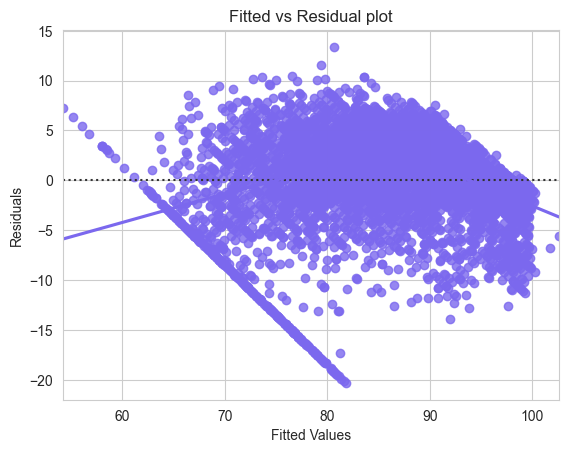

In [66]:
# let us plot the fitted values vs residuals
sns.set_style("whitegrid")
sns.residplot(
    data=df_pred, x="Fitted Values", y="Residuals", color="mediumslateblue", lowess=True
)
plt.xlabel("Fitted Values")
plt.ylabel("Residuals")
plt.title("Fitted vs Residual plot")
plt.show()

In [67]:
from scipy import stats
stats.shapiro(df_pred["Residuals"])

C:\Users\Harsh Patel\anaconda3\Lib\site-packages\scipy\stats\_morestats.py:1882: UserWarning: p-value may not be accurate for N > 5000.
  warnings.warn("p-value may not be accurate for N > 5000.")


ShapiroResult(statistic=0.9400778412818909, pvalue=3.279038406520072e-43)

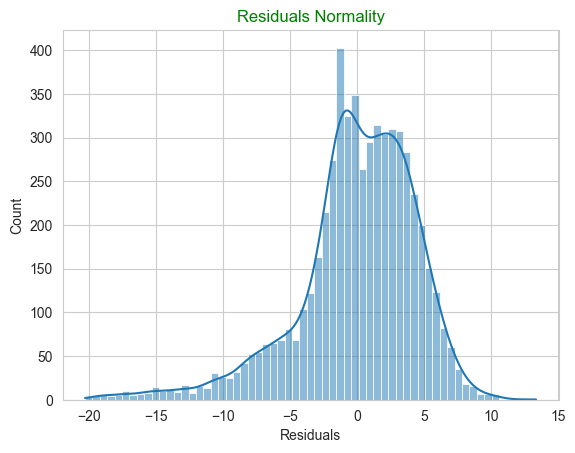

In [68]:
sns.histplot(df_pred["Residuals"], kde=True)
plt.title("Residuals Normality",color ='green')
plt.show()

In [69]:
import statsmodels.stats.api as sms
sms.het_goldfeldquandt(df_pred["Residuals"], X_train)[1]

0.001532260666108734

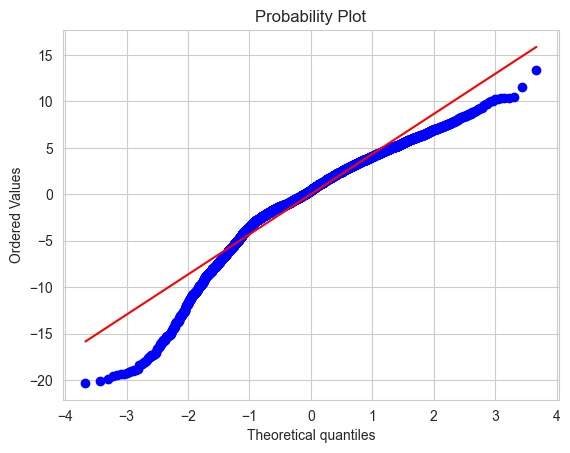

In [70]:
import pylab
import scipy.stats as stats

stats.probplot(df_pred['Residuals'], dist="norm", plot=pylab)
plt.show()

In [71]:
Equation = "usr ="
print(Equation, end=" ")
for i in range(len(X_train.columns)):
    if i == 0:
        print(ols_f3.params[i], "+", end=" ")
    elif i != len(X_train.columns) - 1:
        print(
            ols_f3.params[i],
            "* (",
            X_train.columns[i],
            ")",
            "+",
            end="  ",
        )
    else:
        print(ols_f3.params[i], "* (", X_train.columns[i], ")")

usr = 84.1010304315453 + -0.06297933466942793 * ( lread ) +  0.04922258964686481 * ( lwrite ) +  -0.0006634285574332165 * ( scall ) +  -0.005030621154985168 * ( swrite ) +  -0.30861295913276315 * ( exec ) +  -4.9812041444355575e-06 * ( rchar ) +  -6.249257597140666e-06 * ( wchar ) +  -0.06746527019886578 * ( ppgin ) +  -0.03340794873980873 * ( pflt ) +  -0.005630347901748493 * ( vflt ) +  -0.00037423896319917205 * ( freemem ) +  8.77699842160044e-06 * ( freeswap ) +  1.5197467773217939 * ( runqsz_Not_CPU_Bound )


C:\Users\Harsh Patel\AppData\Local\Temp\ipykernel_16024\3886120964.py:5: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(ols_f3.params[i], "+", end=" ")
C:\Users\Harsh Patel\AppData\Local\Temp\ipykernel_16024\3886120964.py:8: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  ols_f3.params[i],
C:\Users\Harsh Patel\AppData\Local\Temp\ipykernel_16024\3886120964.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(ols_f3.params[i]

In [72]:
X_test.drop(['sread','fork','pgin'],axis=1,inplace = True)

In [73]:
y_pred_test = ols_f3.predict(X_test)
y_pred_train = ols_f3.predict(X_train)

In [74]:
from sklearn.metrics import mean_absolute_error, mean_squared_error
rmse1 = np.sqrt(mean_squared_error(y_train, y_pred_train))
rmse1

4.450707631846364

In [75]:
rmse2 = np.sqrt(mean_squared_error(y_test, y_pred_test))
rmse2

4.684133110665348

### Linear Regression using SKlearn

In [76]:
reg_model = LinearRegression()
reg_model.fit(X_train, y_train)

LinearRegression()

In [77]:
for idx, col_name in enumerate(X_train.columns):
    print("The coefficient for {} is {}".format(col_name, reg_model.coef_[idx]))

The coefficient for const is 0.0
The coefficient for lread is -0.06297933466951755
The coefficient for lwrite is 0.04922258964692485
The coefficient for scall is -0.0006634285574326029
The coefficient for swrite is -0.005030621154992305
The coefficient for exec is -0.30861295913298753
The coefficient for rchar is -4.981204144391768e-06
The coefficient for wchar is -6.249257597087781e-06
The coefficient for ppgin is -0.06746527019888067
The coefficient for pflt is -0.03340794873980397
The coefficient for vflt is -0.00563034790175098
The coefficient for freemem is -0.0003742389631999135
The coefficient for freeswap is 8.776998421617203e-06
The coefficient for runqsz_Not_CPU_Bound is 1.5197467773217939


In [78]:
intercept = reg_model.intercept_
print(f"The intercept for our model is {intercept}")

The intercept for our model is 84.1010304315308


In [79]:
reg_model.score(X_train, y_train)

0.7932223244636325

In [80]:
reg_model.score(X_test, y_test)

0.7645419860579308

In [81]:
pred_train = reg_model.fit(X_train, y_train).predict(X_train)
np.sqrt(mean_squared_error(y_train, pred_train))

4.450707631846364

In [82]:
pred_test = reg_model.fit(X_train, y_train).predict(X_test)
np.sqrt(mean_squared_error(y_test, pred_test))

4.684133110664192

In [83]:
scaler=StandardScaler()
X_train=scaler.fit_transform(X_train)
X_test=scaler.transform(X_test)

### RIDGE REGULARIZATION

In [84]:
ridge_pipeline = Pipeline([
    ('scaler', StandardScaler()),
    ('ridge', Ridge())
])

# Define a range of alpha values to try
ridge_param_grid = {'ridge__alpha': np.logspace(-4, 4, 9)}

# Use GridSearchCV for Ridge regression
ridge_grid_search = GridSearchCV(ridge_pipeline, param_grid=ridge_param_grid, cv=5, scoring='neg_mean_squared_error')
ridge_grid_search.fit(X_train, y_train)

GridSearchCV(cv=5,
             estimator=Pipeline(steps=[('scaler', StandardScaler()),
                                       ('ridge', Ridge())]),
             param_grid={'ridge__alpha': array([1.e-04, 1.e-03, 1.e-02, 1.e-01, 1.e+00, 1.e+01, 1.e+02, 1.e+03,
       1.e+04])},
             scoring='neg_mean_squared_error')

In [85]:
print("Best alpha for Ridge: {}".format(ridge_grid_search.best_params_['ridge__alpha']))

Best alpha for Ridge: 10.0


In [86]:
best_alpha = ridge_grid_search.best_params_['ridge__alpha']
ridge_model = Ridge(alpha=best_alpha)
ridge_model.fit(X_train, y_train)

Ridge(alpha=10.0)

In [87]:
ridge_model.coef_

array([ 0.        , -0.94343574,  0.45065994, -1.05928747, -0.4895856 ,
       -0.63595431, -0.87307088, -0.4451207 , -0.74335801, -3.36710184,
       -0.9644225 , -0.59716068,  3.64954118,  0.75715902])

In [88]:
y_train_pred = ridge_model.predict(X_train)
y_test_pred = ridge_model.predict(X_test)

In [89]:
print(ridge_model.score(X_train, y_train))
print(ridge_model.score(X_test, y_test))

0.7932189240608732
0.76447855974388


In [90]:
rmse1 = np.sqrt(mean_squared_error(y_train, y_train_pred))
print("The Root Mean Squared Error on Train Set: {}".format(rmse1))

The Root Mean Squared Error on Train Set: 4.450744227035505


In [91]:
rmse2 = np.sqrt(mean_squared_error(y_test, y_test_pred))
print("The Root Mean Squared Error on Test Set: {}".format(rmse2))

The Root Mean Squared Error on Test Set: 4.684763960487196


In [92]:
# y_pred_rounded_ridge = [round(val) for val in y_test_pred]
act_pred_ridge_df = pd.DataFrame({
    'Actual': y_test,
    'Predicted': y_test_pred})

act_pred_ridge_df = act_pred_ridge_df.reset_index(drop=True)
act_pred_ridge_df

,Actual,Predicted
0,95.0,97.096091
1,95.0,90.382245
2,61.5,78.488689
3,80.0,77.199217
4,79.0,77.601939
...,...,...
2453,89.0,98.472154
2454,85.0,80.618565
2455,91.0,97.627405
2456,94.0,90.866201


C:\Users\Harsh Patel\AppData\Local\Temp\ipykernel_16024\2205272649.py:2: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "c--o" (-> color='c'). The keyword argument will take precedence.
  plt.plot(act_pred_ridge_df['Actual'][200:300], "c--o", label = "Actual ", c='green')
C:\Users\Harsh Patel\AppData\Local\Temp\ipykernel_16024\2205272649.py:3: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "m--o" (-> color='m'). The keyword argument will take precedence.
  plt.plot(act_pred_ridge_df['Predicted'][200:300], "m--o", label = "Predicted", c='m')


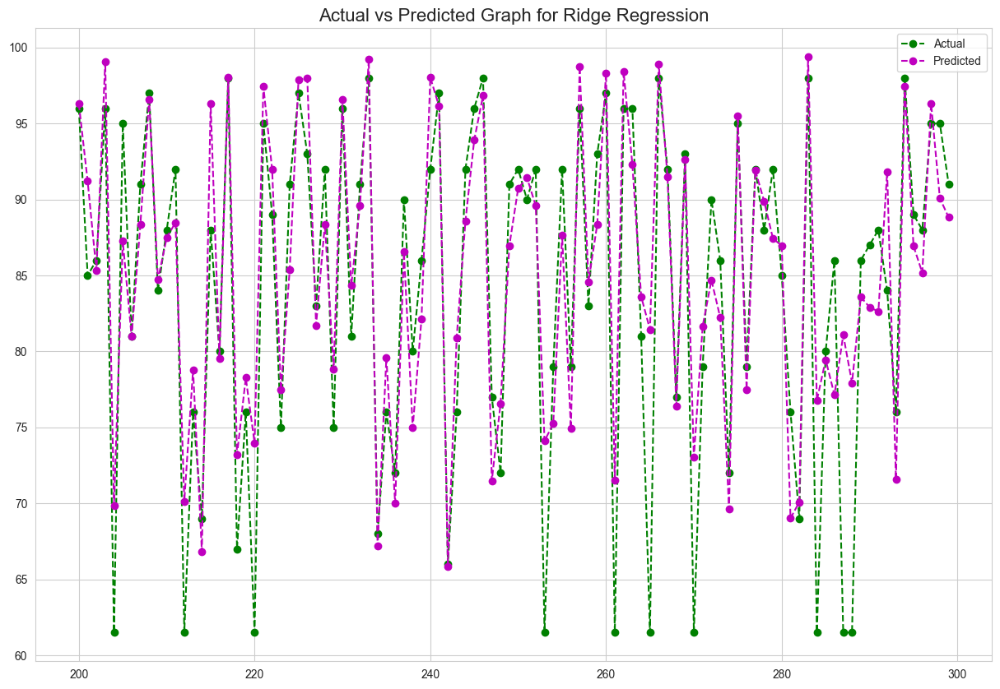

In [93]:
plt.figure(figsize=(15,10))
plt.plot(act_pred_ridge_df['Actual'][200:300], "c--o", label = "Actual ", c='green')
plt.plot(act_pred_ridge_df['Predicted'][200:300], "m--o", label = "Predicted", c='m')
plt.title("Actual vs Predicted Graph for Ridge Regression", fontsize=16)
plt.legend()
plt.savefig("AP-1.jpg")
plt.show()

### LASSO

In [94]:
lasso_pipeline = Pipeline([
    ('scaler', StandardScaler()),
    ('lasso', Lasso())
])

# Define a range of alpha values to try
lasso_param_grid = {'lasso__alpha': np.logspace(-4, 4, 9)}

# Use GridSearchCV for Ridge regression
lasso_grid_search = GridSearchCV(lasso_pipeline, param_grid=lasso_param_grid, cv=5, scoring='neg_mean_squared_error')
lasso_grid_search.fit(X_train, y_train)

GridSearchCV(cv=5,
             estimator=Pipeline(steps=[('scaler', StandardScaler()),
                                       ('lasso', Lasso())]),
             param_grid={'lasso__alpha': array([1.e-04, 1.e-03, 1.e-02, 1.e-01, 1.e+00, 1.e+01, 1.e+02, 1.e+03,
       1.e+04])},
             scoring='neg_mean_squared_error')

In [95]:
print("Best alpha for Lasso: {}".format(lasso_grid_search.best_params_['lasso__alpha']))

Best alpha for Lasso: 0.0001


In [96]:
best_alpha = lasso_grid_search.best_params_['lasso__alpha']
lasso_model = Lasso(alpha=best_alpha)
lasso_model.fit(X_train, y_train)

Lasso(alpha=0.0001)

In [97]:
lasso_model.coef_

array([ 0.        , -0.94808743,  0.45567376, -1.06240717, -0.48478907,
       -0.62913101, -0.87268882, -0.44532194, -0.74733136, -3.41516915,
       -0.92224523, -0.60379581,  3.66408215,  0.75845005])

In [98]:
y_train_pred = lasso_model.predict(X_train)
y_test_pred = lasso_model.predict(X_test)

In [99]:
print(lasso_model.score(X_train, y_train))
print(lasso_model.score(X_test, y_test))

0.7932223223375069
0.7645416464247393


In [100]:
rmse1 = np.sqrt(mean_squared_error(y_train, y_train_pred))
print("The Root Mean Squared Error on Train Set: {}".format(rmse1))

The Root Mean Squared Error on Train Set: 4.4507076547278555


In [101]:
rmse2 = np.sqrt(mean_squared_error(y_test, y_test_pred))
print("The Root Mean Squared Error on Test Set: {}".format(rmse2))

The Root Mean Squared Error on Test Set: 4.684136488944841


In [102]:
y_pred_rounded_lasso = [round(val) for val in y_test_pred]
act_pred_lasso_df = pd.DataFrame({
    'Actual': y_test,
    'Predicted': y_pred_rounded_lasso})

act_pred_lasso_df = act_pred_lasso_df.reset_index(drop=True)
act_pred_lasso_df

,Actual,Predicted
0,95.0,97
1,95.0,90
2,61.5,78
3,80.0,77
4,79.0,78
...,...,...
2453,89.0,98
2454,85.0,81
2455,91.0,98
2456,94.0,91


C:\Users\Harsh Patel\AppData\Local\Temp\ipykernel_16024\378111299.py:2: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "c--o" (-> color='c'). The keyword argument will take precedence.
  plt.plot(act_pred_lasso_df['Actual'][100:200], "c--o", label = "Actual ", c='green')
C:\Users\Harsh Patel\AppData\Local\Temp\ipykernel_16024\378111299.py:3: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "m--o" (-> color='m'). The keyword argument will take precedence.
  plt.plot(act_pred_lasso_df['Predicted'][100:200], "m--o", label = "Predicted", c='m')


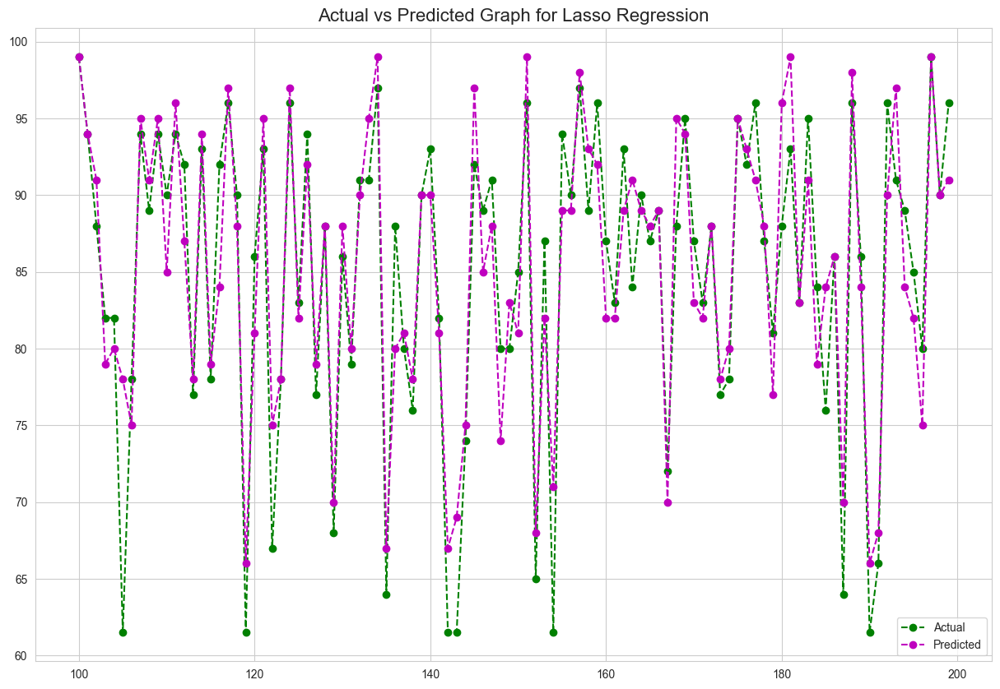

In [103]:
plt.figure(figsize=(15,10))
plt.plot(act_pred_lasso_df['Actual'][100:200], "c--o", label = "Actual ", c='green')
plt.plot(act_pred_lasso_df['Predicted'][100:200], "m--o", label = "Predicted", c='m')
plt.title("Actual vs Predicted Graph for Lasso Regression", fontsize=16)
plt.legend()
plt.savefig("ap-2.jpg")
plt.show()

# PROBLEM-2:
----------------------------------------------------
In your role as a statistician at the Republic of Indonesia Ministry of Health, you have been entrusted with a dataset containing information from a Contraceptive Prevalence Survey. This dataset encompasses data from 1473 married females who were either not pregnant or were uncertain of their pregnancy status during the survey.

Your task involves predicting whether these women opt for a contraceptive method of choice. This prediction will be based on a comprehensive analysis of their demographic and socio-economic attributes.

---------------------------------------------------

### EDA and Data pre processing

* Now, we will load our file using read_excel function and see it's first and last five rows. Then, we get the shape, data type and description of the dataset.
* We will also check and remove any duplicated rows as well as find out any empty or null values and replace it with the median of that respective variable that the cell or data found to be missing.

In [104]:
df_cont = pd.read_excel("Contraceptive_method_dataset.xlsx")

In [105]:
df_cont.head()

,Wife_age,Wife_ education,Husband_education,No_of_children_born,Wife_religion,Wife_Working,Husband_Occupation,Standard_of_living_index,Media_exposure,Contraceptive_method_used
0,24.0,Primary,Secondary,3.0,Scientology,No,2,High,Exposed,No
1,45.0,Uneducated,Secondary,10.0,Scientology,No,3,Very High,Exposed,No
2,43.0,Primary,Secondary,7.0,Scientology,No,3,Very High,Exposed,No
3,42.0,Secondary,Primary,9.0,Scientology,No,3,High,Exposed,No
4,36.0,Secondary,Secondary,8.0,Scientology,No,3,Low,Exposed,No


In [106]:
df_cont.tail()

,Wife_age,Wife_ education,Husband_education,No_of_children_born,Wife_religion,Wife_Working,Husband_Occupation,Standard_of_living_index,Media_exposure,Contraceptive_method_used
1468,33.0,Tertiary,Tertiary,NaN,Scientology,Yes,2,Very High,Exposed,Yes
1469,33.0,Tertiary,Tertiary,NaN,Scientology,No,1,Very High,Exposed,Yes
1470,39.0,Secondary,Secondary,NaN,Scientology,Yes,1,Very High,Exposed,Yes
1471,33.0,Secondary,Secondary,NaN,Scientology,Yes,2,Low,Exposed,Yes
1472,17.0,Secondary,Secondary,1.0,Scientology,No,2,Very High,Exposed,Yes


In [107]:
df_cont.shape

(1473, 10)

In [108]:
df_cont.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1473 entries, 0 to 1472
Data columns (total 10 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   Wife_age                   1402 non-null   float64
 1   Wife_ education            1473 non-null   object 
 2   Husband_education          1473 non-null   object 
 3   No_of_children_born        1452 non-null   float64
 4   Wife_religion              1473 non-null   object 
 5   Wife_Working               1473 non-null   object 
 6   Husband_Occupation         1473 non-null   int64  
 7   Standard_of_living_index   1473 non-null   object 
 8   Media_exposure             1473 non-null   object 
 9   Contraceptive_method_used  1473 non-null   object 
dtypes: float64(2), int64(1), object(7)
memory usage: 115.2+ KB


In [109]:
df_cont.isnull().sum()

Wife_age                     71
Wife_ education               0
Husband_education             0
No_of_children_born          21
Wife_religion                 0
Wife_Working                  0
Husband_Occupation            0
Standard_of_living_index      0
Media_exposure                0
Contraceptive_method_used     0
dtype: int64

In [110]:
df_cont['Wife_age'] = df_cont[['Wife_age']].apply(lambda x : x.fillna(x.mean()))
df_cont['No_of_children_born'] = df_cont[['No_of_children_born']].apply(lambda x : x.fillna(x.median()))

In [111]:
df_cont.isnull().sum()

Wife_age                     0
Wife_ education              0
Husband_education            0
No_of_children_born          0
Wife_religion                0
Wife_Working                 0
Husband_Occupation           0
Standard_of_living_index     0
Media_exposure               0
Contraceptive_method_used    0
dtype: int64

In [112]:
df_cont.duplicated().sum()

82

In [113]:
df_cont.drop_duplicates(inplace=True)

In [114]:
df_cont.duplicated().sum()

0

In [115]:
df_cont.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1391 entries, 0 to 1472
Data columns (total 10 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   Wife_age                   1391 non-null   float64
 1   Wife_ education            1391 non-null   object 
 2   Husband_education          1391 non-null   object 
 3   No_of_children_born        1391 non-null   float64
 4   Wife_religion              1391 non-null   object 
 5   Wife_Working               1391 non-null   object 
 6   Husband_Occupation         1391 non-null   int64  
 7   Standard_of_living_index   1391 non-null   object 
 8   Media_exposure             1391 non-null   object 
 9   Contraceptive_method_used  1391 non-null   object 
dtypes: float64(2), int64(1), object(7)
memory usage: 119.5+ KB


In [116]:
df_cont.describe().T

,count,mean,std,min,25%,50%,75%,max
Wife_age,1391.0,32.561913,8.092559,16.0,26.0,32.0,38.0,49.0
No_of_children_born,1391.0,3.286844,2.383479,0.0,1.0,3.0,5.0,16.0
Husband_Occupation,1391.0,2.176132,0.854041,1.0,1.0,2.0,3.0,4.0


In [117]:
for feature in df_cont.columns:
    if df_cont[feature].dtype == 'object':
        #print("\t")
        print(df_cont[feature].value_counts())
        print("\n")

Wife_ education
Tertiary      513
Secondary     398
Primary       330
Uneducated    150
Name: count, dtype: int64


Husband_education
Tertiary      825
Secondary     347
Primary       175
Uneducated     44
Name: count, dtype: int64


Wife_religion
Scientology        1184
Non-Scientology     207
Name: count, dtype: int64


Wife_Working
No     1041
Yes     350
Name: count, dtype: int64


Standard_of_living_index
Very High    616
High         419
Low          227
Very Low     129
Name: count, dtype: int64


Media_exposure 
Exposed        1282
Not-Exposed     109
Name: count, dtype: int64


Contraceptive_method_used
Yes    777
No     614
Name: count, dtype: int64




### UNIVARIATE ANALYSIS

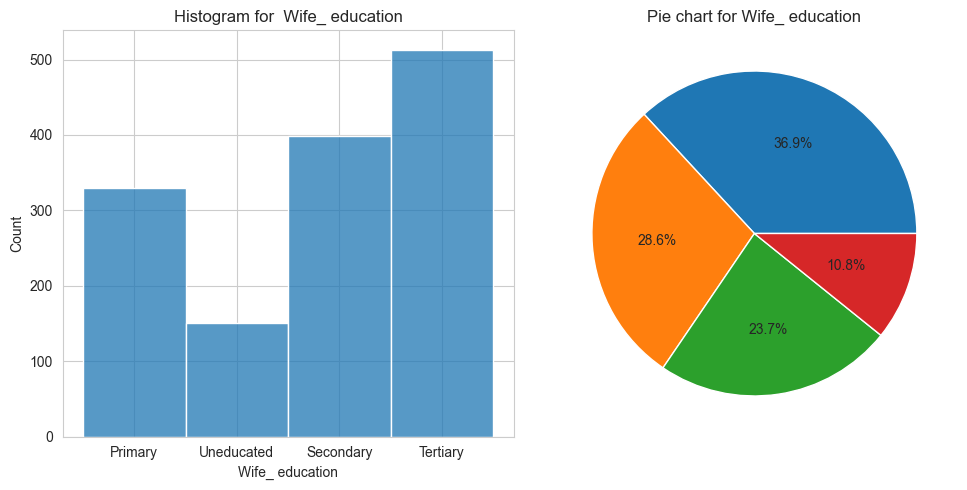

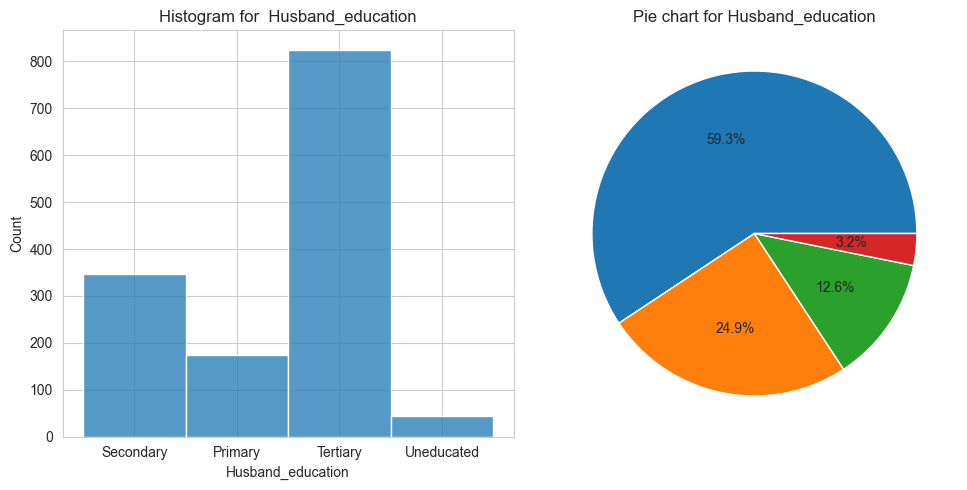

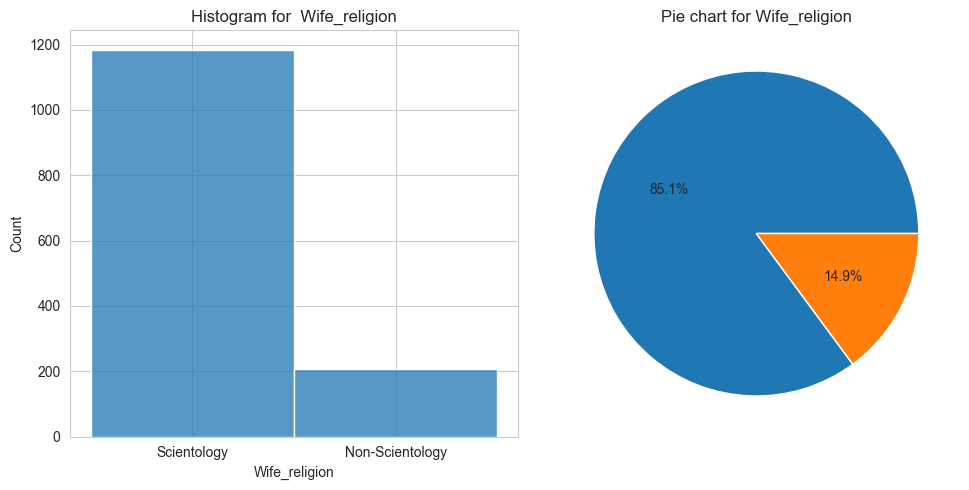

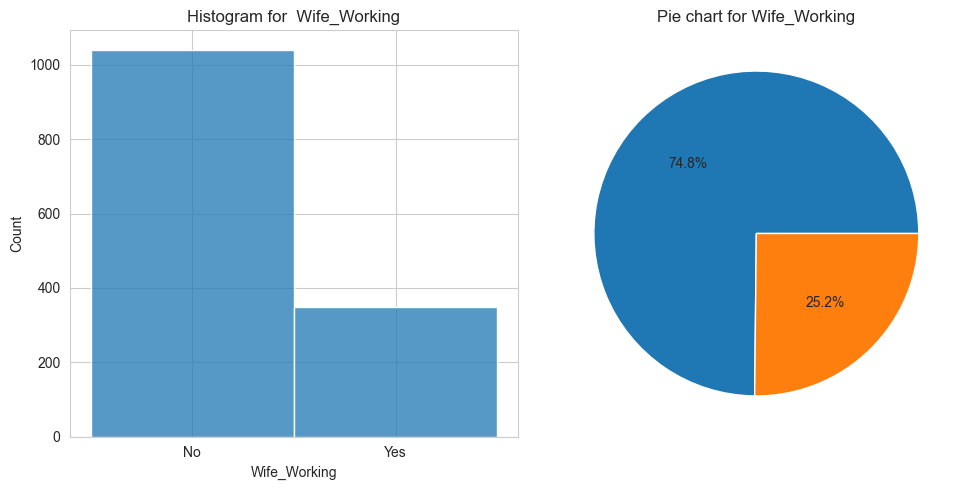

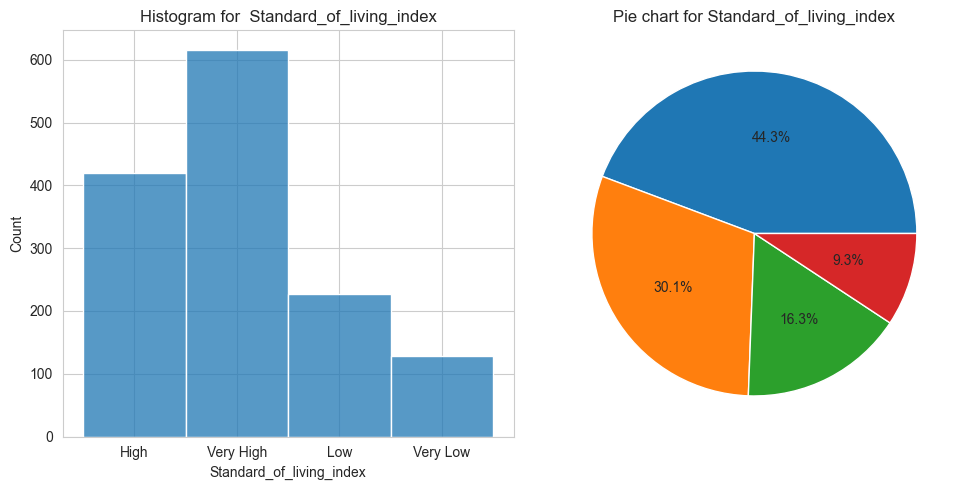

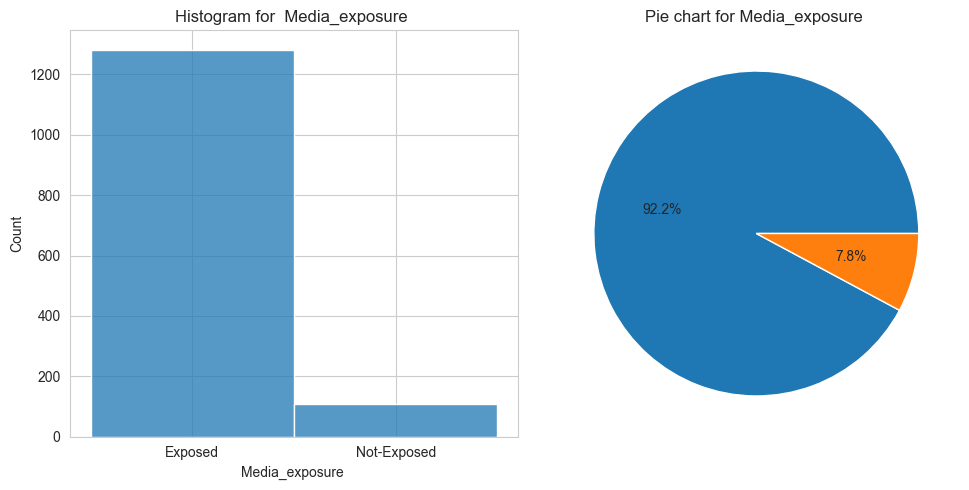

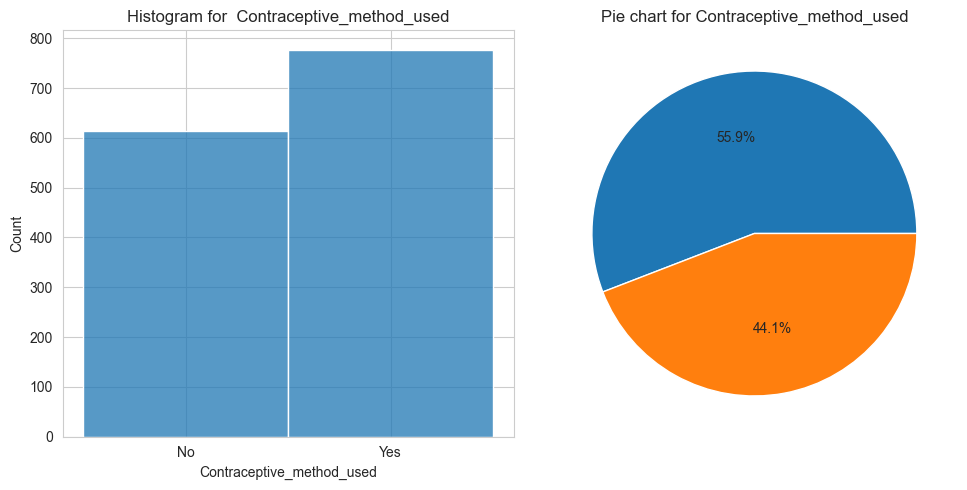

In [118]:
for feature in df_cont.columns:
    if df_cont[feature].dtype == 'object':
            plt.figure(figsize=(10, 5))
            plt.subplot(1, 2, 1)
            plt.title(f'Histogram for  {feature}')
            sns.histplot(df_cont[feature])
            plt.subplot(1, 2, 2)
            plt.title(f'Pie chart for {feature}')
            plt.pie(df_cont[feature].value_counts(), autopct='%1.1f%%')
            plt.tight_layout()
            plt.show()

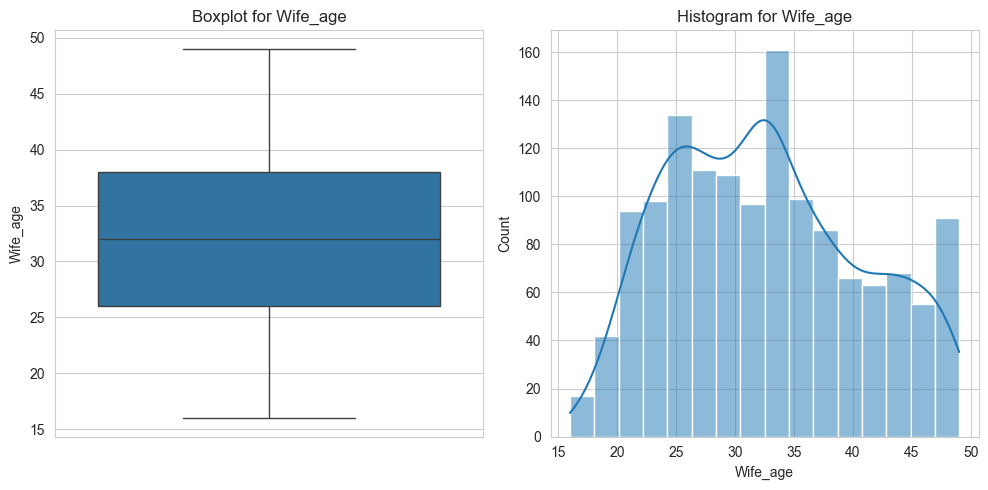

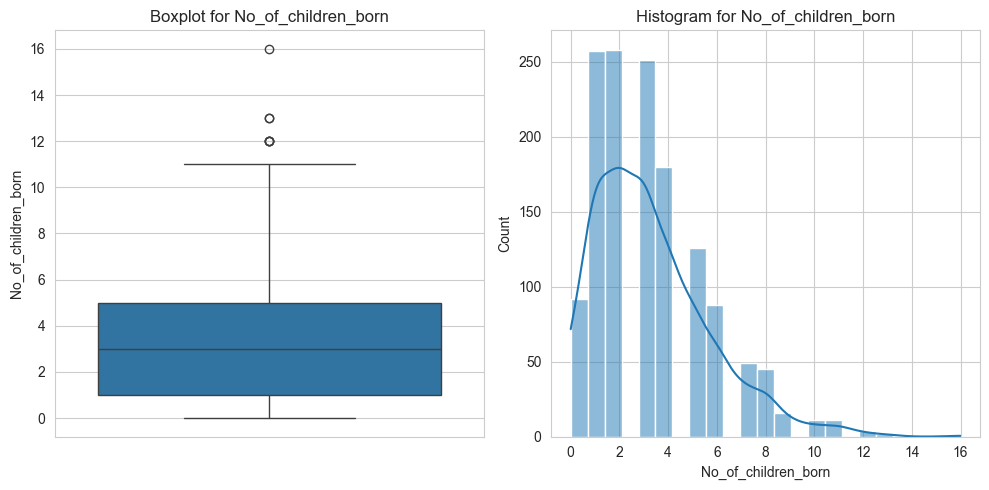

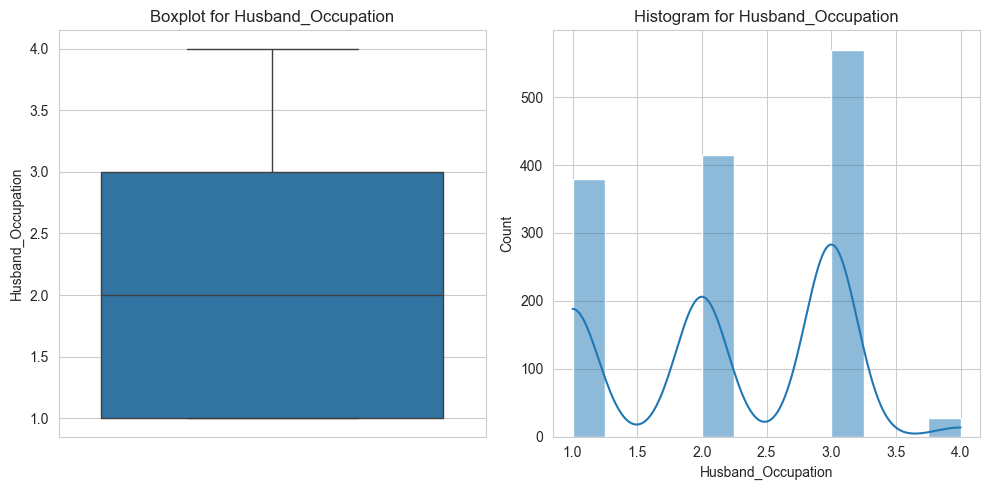

In [119]:
num_cols = ['Wife_age', 'No_of_children_born', 'Husband_Occupation']
for col_name in num_cols:
    plt.figure(figsize=(10, 5))
    plt.subplot(1, 2, 1)
    plt.title('Boxplot for {}'.format(col_name))
    sns.boxplot(y=df_cont[col_name])

    plt.subplot(1, 2, 2)
    plt.title('Histogram for {}'.format(col_name))
    sns.histplot(df_cont[col_name], kde=True)

    plt.tight_layout()
    plt.show()

In [120]:
for column in df_cont.select_dtypes(include=np.number).columns:
    
    q1 = df_cont[column].quantile(0.25)
    q3 = df_cont[column].quantile(0.75)
    IQR = q3 - q1
    
    uplim = q3 + (1.5 * IQR)
    lowlim = q1 - (1.5 * IQR)
    
    df_cont[column] = np.where(df_cont[column] < lowlim, lowlim, df_cont[column])
    df_cont[column] = np.where(df_cont[column] > uplim, uplim, df_cont[column])


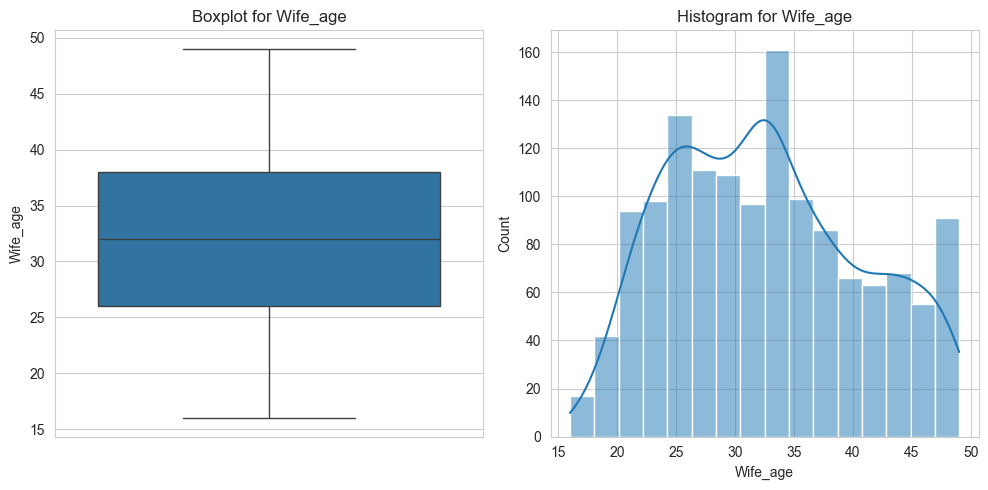

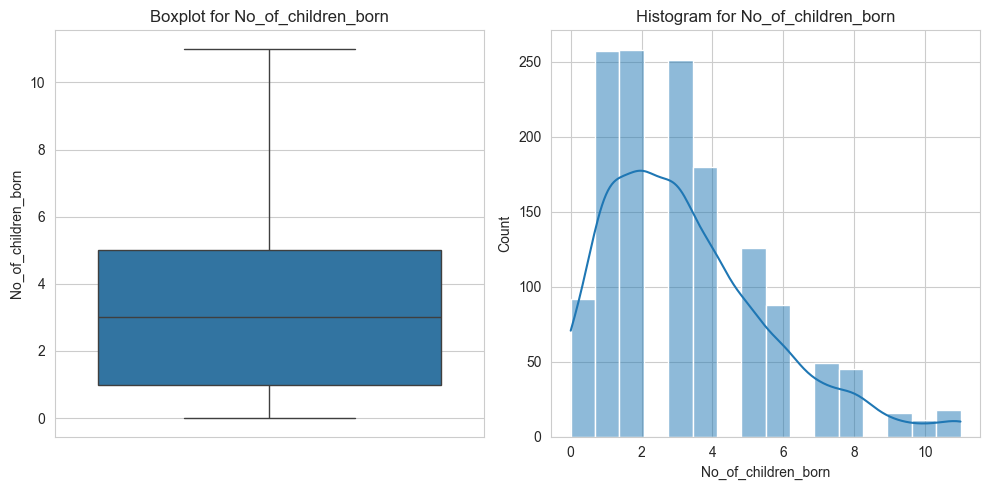

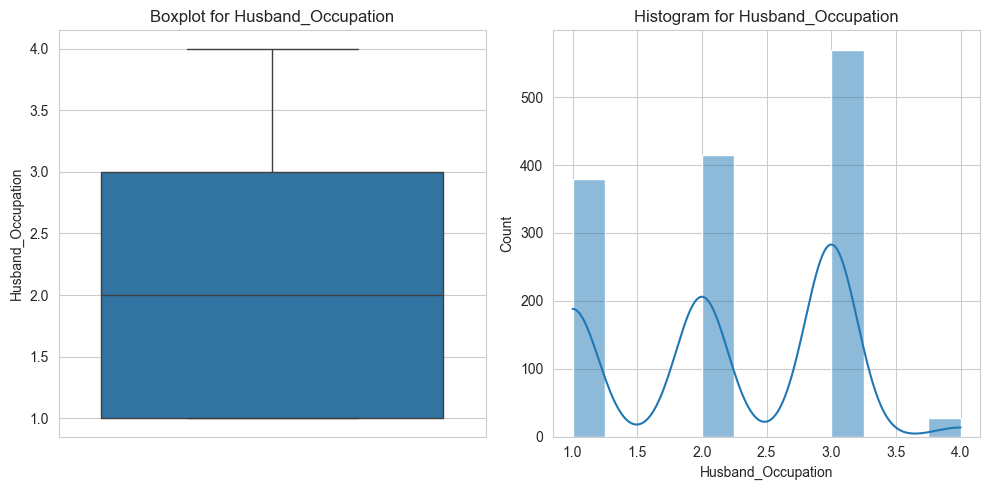

In [121]:
num_cols = ['Wife_age', 'No_of_children_born', 'Husband_Occupation']
for col_name in num_cols:
    plt.figure(figsize=(10, 5))
    plt.subplot(1, 2, 1)
    plt.title('Boxplot for {}'.format(col_name))
    sns.boxplot(y=df_cont[col_name])

    plt.subplot(1, 2, 2)
    plt.title('Histogram for {}'.format(col_name))
    sns.histplot(df_cont[col_name], kde=True)

    plt.tight_layout()
    plt.show()

### MULTI-VARIATE ANALYSIS:

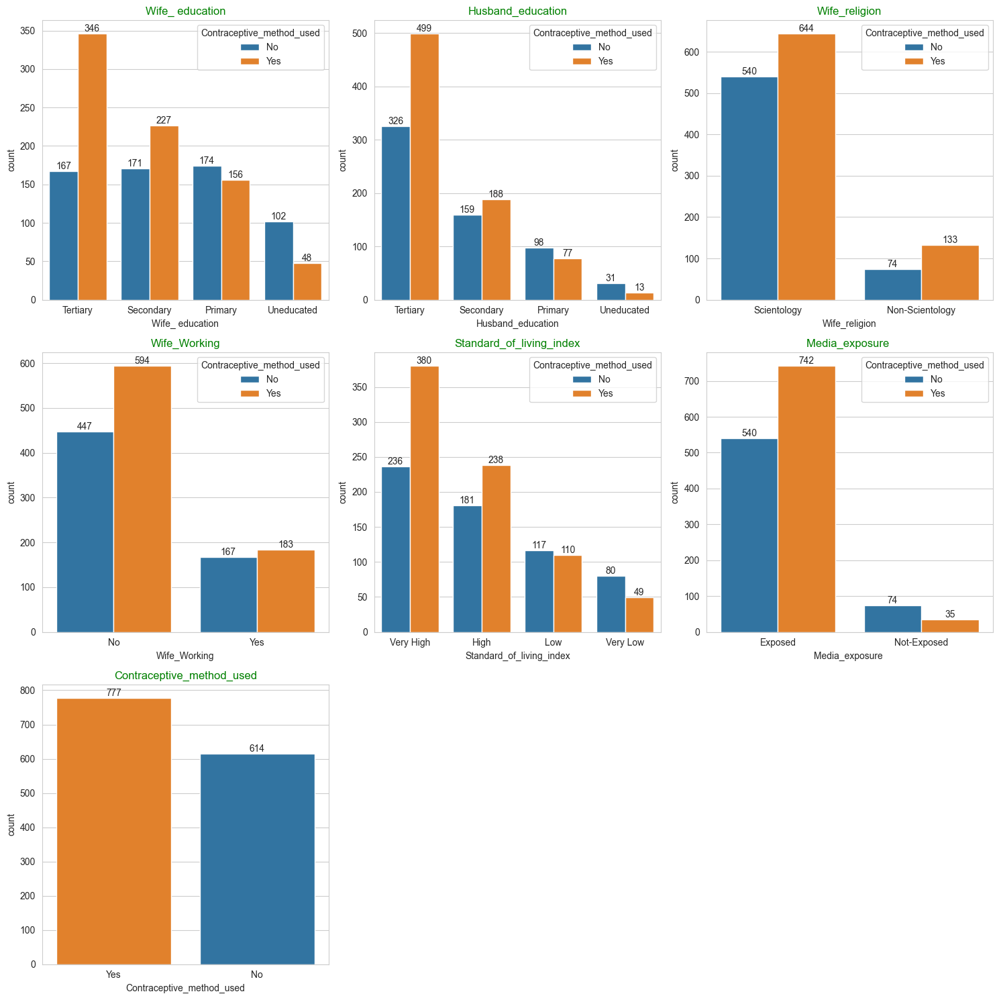

In [122]:
fig=plt.figure(figsize=(15,15))
cols = df_cont.select_dtypes(include='object').columns
for i in range(0,len(cols)):    
    plt.subplot(3,3,i+1)
    ax=sns.countplot(x=df_cont[cols[i]],data=df_cont,order=df_cont[cols[i]].value_counts().index,hue='Contraceptive_method_used')
    for bars in ax.containers:
        ax.bar_label(bars)
    plt.title("{}".format(cols[i]),color='green')
    plt.tight_layout()     

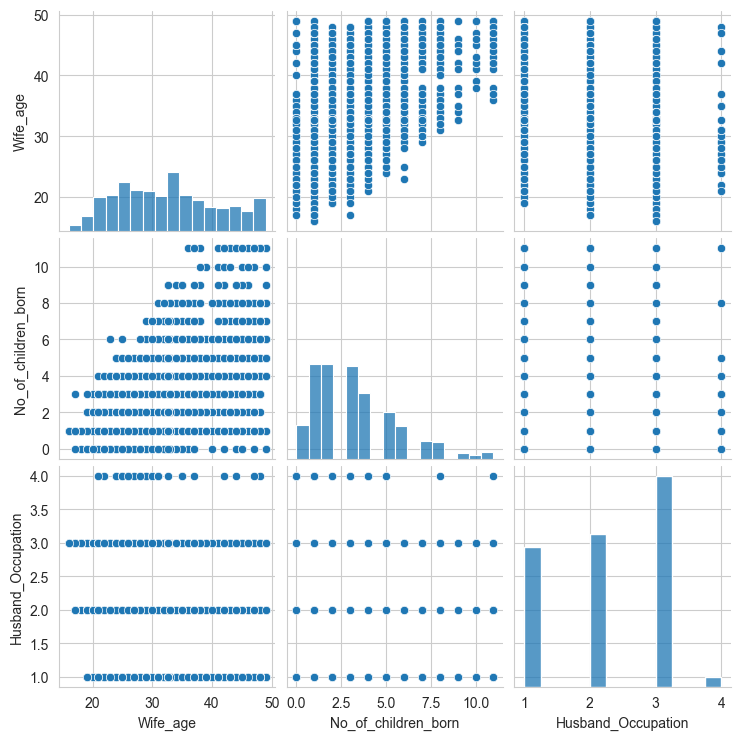

In [123]:
sns.pairplot(df_cont, vars=['Wife_age', 'No_of_children_born', 'Husband_Occupation'])

In [124]:
corr1 = pd.DataFrame(df_cont,columns=['Wife_age', 'No_of_children_born','Husband_Occupation'])
corr_df = corr1.corr()
corr_df

,Wife_age,No_of_children_born,Husband_Occupation
Wife_age,1.000000,0.530683,-0.186458
No_of_children_born,0.530683,1.000000,-0.022245
Husband_Occupation,-0.186458,-0.022245,1.000000


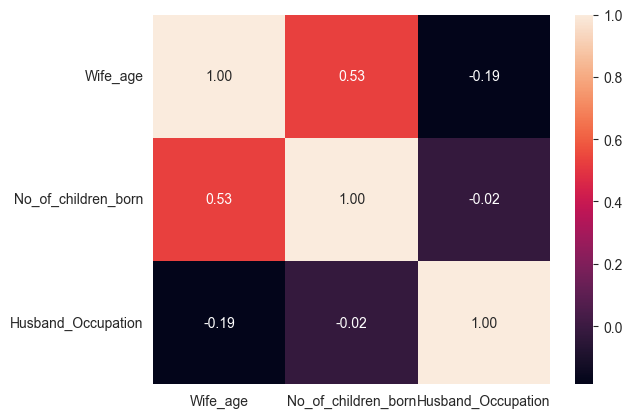

In [125]:
sns.heatmap(corr_df, annot=True, fmt=".2f")
#plt.title("Correlations heat map for all continuous variables")

# Show the plot
plt.show()

#### ENCODING THE DATASET

In [126]:
df_cont['Wife_ education'] = np.where(df_cont['Wife_ education']=='Uneducated', '1', df_cont['Wife_ education'])
df_cont['Wife_ education'] = np.where(df_cont['Wife_ education']=='Primary', '2', df_cont['Wife_ education'])
df_cont['Wife_ education'] = np.where(df_cont['Wife_ education']=='Secondary', '3', df_cont['Wife_ education'])
df_cont['Wife_ education'] = np.where(df_cont['Wife_ education']=='Tertiary', '4', df_cont['Wife_ education'])

In [127]:
df_cont['Husband_education'] = np.where(df_cont['Husband_education']=='Uneducated', '1', df_cont['Husband_education'])
df_cont['Husband_education'] = np.where(df_cont['Husband_education']=='Primary', '2', df_cont['Husband_education'])
df_cont['Husband_education'] = np.where(df_cont['Husband_education']=='Secondary', '3', df_cont['Husband_education'])
df_cont['Husband_education'] = np.where(df_cont['Husband_education']=='Tertiary', '4', df_cont['Husband_education'])

In [128]:
df_cont['Standard_of_living_index']=np.where(df_cont['Standard_of_living_index']=='Very Low','1',df_cont['Standard_of_living_index'])
df_cont['Standard_of_living_index']=np.where(df_cont['Standard_of_living_index']=='Low','2',df_cont['Standard_of_living_index'])
df_cont['Standard_of_living_index']=np.where(df_cont['Standard_of_living_index']=='High','3',df_cont['Standard_of_living_index'])
df_cont['Standard_of_living_index']=np.where(df_cont['Standard_of_living_index']=='Very High','4',df_cont['Standard_of_living_index'])

In [129]:
df_cont['Wife_ education'] = df_cont['Wife_ education'].astype('int64')
df_cont['Husband_education'] = df_cont['Husband_education'].astype('int64')
df_cont['Standard_of_living_index'] = df_cont['Standard_of_living_index'].astype('int64')

In [130]:
df_cont['Contraceptive_method_used'] = df_cont['Contraceptive_method_used'].replace({'Yes':1, 'No':0})
df_cont['Contraceptive_method_used'] = df_cont['Contraceptive_method_used'].astype('int64')

In [131]:
New_cont = pd.get_dummies(df_cont,drop_first=True)
New_cont.head()

,Wife_age,Wife_ education,Husband_education,No_of_children_born,Husband_Occupation,Standard_of_living_index,Contraceptive_method_used,Wife_religion_Scientology,Wife_Working_Yes,Media_exposure _Not-Exposed
0,24.0,2,3,3.0,2.0,3,0,True,False,False
1,45.0,1,3,10.0,3.0,4,0,True,False,False
2,43.0,2,3,7.0,3.0,4,0,True,False,False
3,42.0,3,2,9.0,3.0,3,0,True,False,False
4,36.0,3,3,8.0,3.0,2,0,True,False,False


In [132]:
New_cont.Wife_religion_Scientology = New_cont.Wife_religion_Scientology.astype('int64')
New_cont.Wife_Working_Yes = New_cont.Wife_Working_Yes.astype('int64')
New_cont['Media_exposure _Not-Exposed'] = New_cont['Media_exposure _Not-Exposed'].astype('int64')

In [133]:
New_cont.head()

,Wife_age,Wife_ education,Husband_education,No_of_children_born,Husband_Occupation,Standard_of_living_index,Contraceptive_method_used,Wife_religion_Scientology,Wife_Working_Yes,Media_exposure _Not-Exposed
0,24.0,2,3,3.0,2.0,3,0,1,0,0
1,45.0,1,3,10.0,3.0,4,0,1,0,0
2,43.0,2,3,7.0,3.0,4,0,1,0,0
3,42.0,3,2,9.0,3.0,3,0,1,0,0
4,36.0,3,3,8.0,3.0,2,0,1,0,0


In [134]:
New_cont.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1391 entries, 0 to 1472
Data columns (total 10 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   Wife_age                     1391 non-null   float64
 1   Wife_ education              1391 non-null   int64  
 2   Husband_education            1391 non-null   int64  
 3   No_of_children_born          1391 non-null   float64
 4   Husband_Occupation           1391 non-null   float64
 5   Standard_of_living_index     1391 non-null   int64  
 6   Contraceptive_method_used    1391 non-null   int64  
 7   Wife_religion_Scientology    1391 non-null   int64  
 8   Wife_Working_Yes             1391 non-null   int64  
 9   Media_exposure _Not-Exposed  1391 non-null   int64  
dtypes: float64(3), int64(7)
memory usage: 119.5 KB


#### SPLIT INTO TRAIN-TEST:

In [135]:
X = New_cont.drop('Contraceptive_method_used',axis=1)
y = New_cont['Contraceptive_method_used']

In [136]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.30, random_state=1,stratify=New_cont['Contraceptive_method_used'])

In [137]:
stand_scal = StandardScaler()
X_train = stand_scal.fit_transform(X_train)
X_test = stand_scal.transform (X_test)

### LOGISTIC REGRESSION

In [138]:
model = LogisticRegression()
model.fit(X_train, y_train)

LogisticRegression()

In [139]:
y_train_predict = model.predict(X_train)
y_test_predict = model.predict(X_test)

In [140]:
model_score_train = model.score(X_train, y_train)
print(model_score_train)
model_score_test = model.score(X_test, y_test)
print(model_score_test)

0.6721479958890031
0.645933014354067


In [141]:
print(metrics.confusion_matrix(y_train, y_train_predict))
print(metrics.classification_report(y_train, y_train_predict))

[[222 207]
 [112 432]]
              precision    recall  f1-score   support

           0       0.66      0.52      0.58       429
           1       0.68      0.79      0.73       544

    accuracy                           0.67       973
   macro avg       0.67      0.66      0.66       973
weighted avg       0.67      0.67      0.66       973



In [142]:
print(metrics.confusion_matrix(y_test, y_test_predict))
print(metrics.classification_report(y_test, y_test_predict))

[[ 84 101]
 [ 47 186]]
              precision    recall  f1-score   support

           0       0.64      0.45      0.53       185
           1       0.65      0.80      0.72       233

    accuracy                           0.65       418
   macro avg       0.64      0.63      0.62       418
weighted avg       0.65      0.65      0.63       418



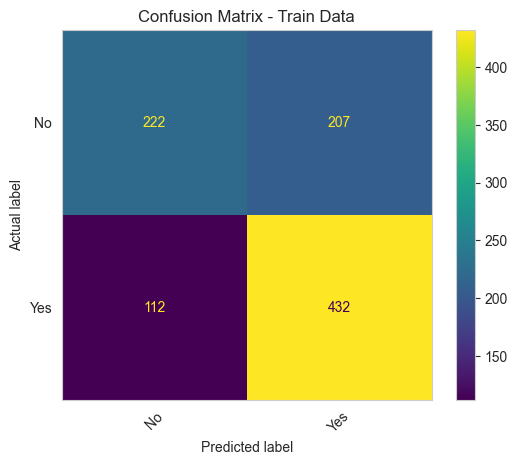

In [143]:
cm = confusion_matrix(y_train, y_train_predict, labels=model.classes_)
disp = ConfusionMatrixDisplay(confusion_matrix=cm,
                              display_labels=model.classes_)
disp.plot()
classNames = ['No', 'Yes']
plt.title('Confusion Matrix - Train Data')
plt.ylabel('Actual label')
plt.xlabel('Predicted label')
tick_marks = np.arange(len(classNames))
plt.xticks(tick_marks, classNames, rotation=45)
plt.yticks(tick_marks, classNames)
plt.grid(False)
# for i in range(2):
#     for j in range(2):
#         plt.text(j,i, str(s[i][j])+" = "+str(cm[i][j]))
plt.show()

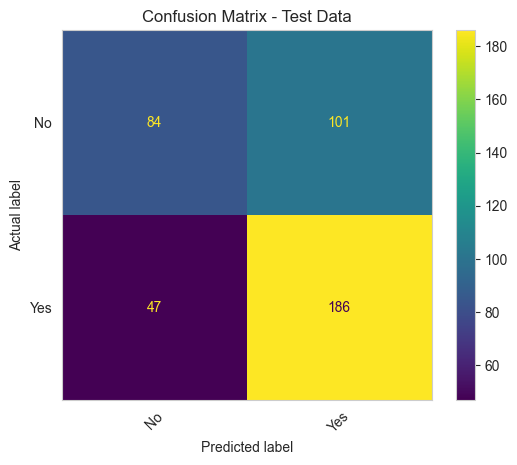

In [144]:
# cm = metrics.confusion_matrix(y_test, y_predict)
# plt.clf()
# plt.imshow(cm, interpolation='nearest')
cm = confusion_matrix(y_test, y_test_predict, labels=model.classes_)
disp = ConfusionMatrixDisplay(confusion_matrix=cm,
                              display_labels=model.classes_)
disp.plot()
classNames = ['No', 'Yes']
plt.title('Confusion Matrix - Test Data')
plt.ylabel('Actual label')
plt.xlabel('Predicted label')
tick_marks = np.arange(len(classNames))
plt.xticks(tick_marks, classNames, rotation=45)
plt.yticks(tick_marks, classNames)
plt.grid(False)
# for i in range(2):
#     for j in range(2):
#         plt.text(j,i, str(s[i][j])+" = "+str(cm[i][j]))
plt.show()

Train_AUC: 0.718
Test_AUC: 0.664


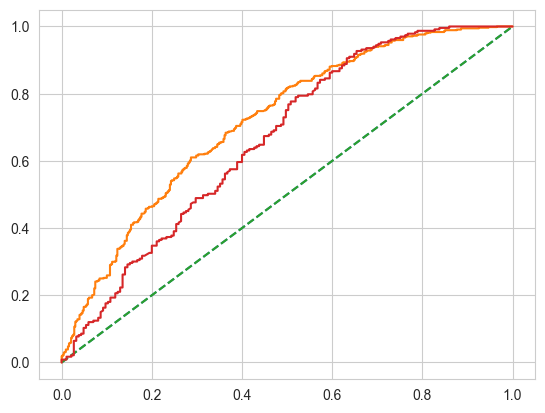

In [145]:
# predict probabilities
probs = model.predict_proba(X_train)
# keep probabilities for the positive outcome only
probs = probs[:, 1]
# calculate AUC
auc = roc_auc_score(y_train, probs)
print('Train_AUC: %.3f' % auc)
# calculate roc curve
train_fpr, train_tpr, train_thresholds = roc_curve(y_train, probs)
plt.plot([0, 1], [0, 1], linestyle='--')
# plot the roc curve for the model
plt.plot(train_fpr, train_tpr);

# predict probabilities
probs = model.predict_proba(X_test)
# keep probabilities for the positive outcome only
probs = probs[:, 1]
# calculate AUC
test_auc = roc_auc_score(y_test, probs)
print('Test_AUC: %.3f' % test_auc)
# calculate roc curve
test_fpr, test_tpr, test_thresholds = roc_curve(y_test, probs)
plt.plot([0, 1], [0, 1], linestyle='--')
# plot the roc curve for the model
plt.plot(test_fpr, test_tpr);

AUC: 0.664


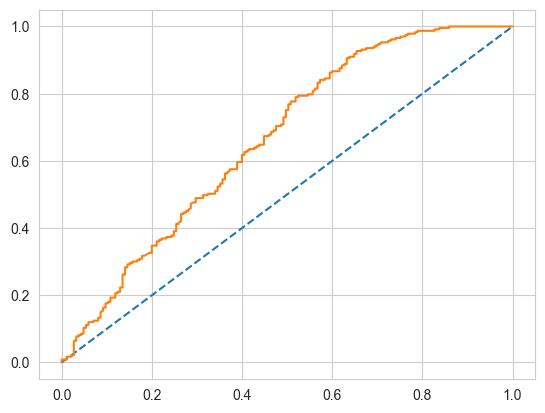

In [146]:
# predict probabilities
probs = model.predict_proba(X_test)
# keep probabilities for the positive outcome only
probs = probs[:, 1]
# calculate AUC
test_auc = roc_auc_score(y_test, probs)
print('AUC: %.3f' % test_auc)
# calculate roc curve
test_fpr, test_tpr, test_thresholds = roc_curve(y_test, probs)
plt.plot([0, 1], [0, 1], linestyle='--')
# plot the roc curve for the model
plt.plot(test_fpr, test_tpr);

### Linear Discriminant Analysis

In [147]:
clf = LinearDiscriminantAnalysis()
model=clf.fit(X_train,y_train)
model

LinearDiscriminantAnalysis()

In [148]:
clf.intercept_

array([0.2801675])

In [149]:
clf.coef_

array([[-0.60087221,  0.51751748,  0.02525942,  0.75574918,  0.14486395,
         0.3118479 , -0.17916565, -0.07764848, -0.09164812]])

In [150]:
# for idx, col_name in enumerate(X_train.columns):
#     print("The coefficient for {} is {}".format(col_name, clf.coef_[idx]))

In [151]:
# print('Contraceptive_method_used = ')
# for i in range(len(X_train.columns)):
#     print('{} x {} +'.format(round(clf.coef_[0][i],2),X_train.columns[i]),end=" ")

In [152]:
pred_class_train = model.predict(X_train)
pred_class_test = model.predict(X_test)

CONFUSION MATRIX:


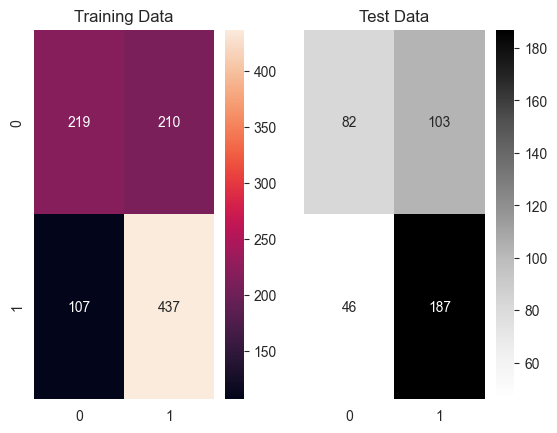

In [153]:
f,a =  plt.subplots(1,2,sharex=True,sharey=True,squeeze=False)

#Plotting confusion matrix for the different models for the Training Data
print('CONFUSION MATRIX:')

plot_0 = sns.heatmap((metrics.confusion_matrix(y_train,pred_class_train)),annot=True,fmt='.5g',ax=a[0][0]);
a[0][0].set_title('Training Data')

plot_1 = sns.heatmap((metrics.confusion_matrix(y_test,pred_class_test)),annot=True,fmt='.5g',cmap='Greys',ax=a[0][1]);
a[0][1].set_title('Test Data');

In [154]:
print('Classification Report of the training data:\n\n',metrics.classification_report(y_train,pred_class_train),'\n')


Classification Report of the training data:

               precision    recall  f1-score   support

           0       0.67      0.51      0.58       429
           1       0.68      0.80      0.73       544

    accuracy                           0.67       973
   macro avg       0.67      0.66      0.66       973
weighted avg       0.67      0.67      0.67       973
 



In [155]:
print('Classification Report of the test data:\n\n',metrics.classification_report(y_test,pred_class_test),'\n')

Classification Report of the test data:

               precision    recall  f1-score   support

           0       0.64      0.44      0.52       185
           1       0.64      0.80      0.72       233

    accuracy                           0.64       418
   macro avg       0.64      0.62      0.62       418
weighted avg       0.64      0.64      0.63       418
 



In [156]:
pred_prob_train = model.predict_proba(X_train)
pred_prob_test = model.predict_proba(X_test)

AUC for the Training Data: 0.718
AUC for the Test Data: 0.664


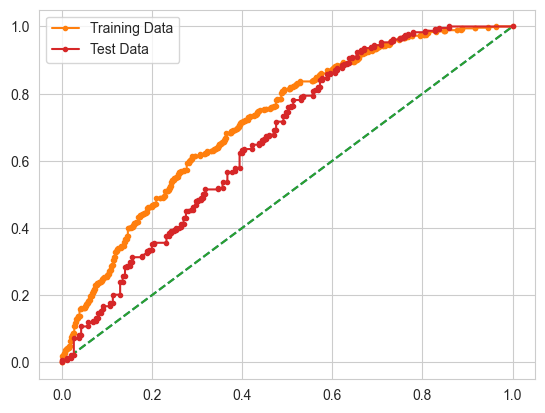

In [157]:
# AUC and ROC for the training data

# calculate AUC
auc = metrics.roc_auc_score(y_train,pred_prob_train[:,1])
print('AUC for the Training Data: %.3f' % auc)

#  calculate roc curve
fpr, tpr, thresholds = metrics.roc_curve(y_train,pred_prob_train[:,1])
plt.plot([0, 1], [0, 1], linestyle='--')
# plot the roc curve for the model
plt.plot(fpr, tpr, marker='.',label = 'Training Data')


# AUC and ROC for the test data

# calculate AUC
auc = metrics.roc_auc_score(y_test,pred_prob_test[:,1])
print('AUC for the Test Data: %.3f' % auc)

#  calculate roc curve
fpr, tpr, thresholds = metrics.roc_curve(y_test,pred_prob_test[:,1])
plt.plot([0, 1], [0, 1], linestyle='--')
# plot the roc curve for the model
plt.plot(fpr, tpr, marker='.',label='Test Data')
# show the plot
plt.legend(loc='best')
plt.show()

AUC for the Test Data: 0.664


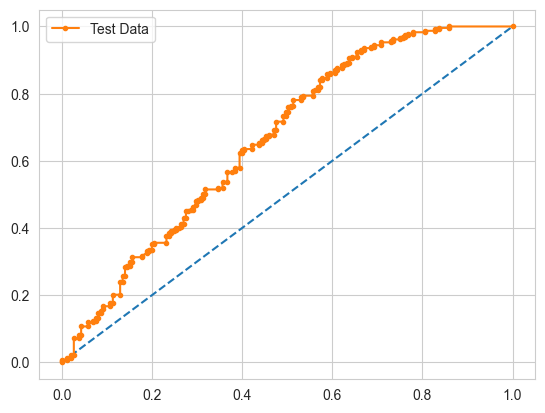

In [158]:


# AUC and ROC for the test data# calculate AUC
auc = metrics.roc_auc_score(y_test,pred_prob_test[:,1])
print('AUC for the Test Data: %.3f' % auc)

#  calculate roc curve
fpr, tpr, thresholds = metrics.roc_curve(y_test,pred_prob_test[:,1])
plt.plot([0, 1], [0, 1], linestyle='--')
# plot the roc curve for the model
plt.plot(fpr, tpr, marker='.',label='Test Data')
# show the plot
plt.legend(loc='best')
plt.show()

### CARTS METHOD

In [159]:
X_train, X_test, train_labels, test_labels = train_test_split(X, y, test_size=.30, random_state=7) # 70% training 30% Testing 


In [160]:
dt_model = DecisionTreeClassifier(criterion = 'gini' )

In [161]:
dt_model.fit(X_train, train_labels)

DecisionTreeClassifier()

In [162]:

train_char_label = ['No', 'Yes']
Tree_File = open('C:\\Users\Harsh Patel\Desktop\Tree.dot','w')
dot_data = tree.export_graphviz(dt_model, out_file=Tree_File, feature_names = list(X_train), class_names = list(train_char_label))

Tree_File.close()


In [163]:
print (pd.DataFrame(dt_model.feature_importances_, columns = ["Imp"], index = X_train.columns))


                                  Imp
Wife_age                     0.307554
Wife_ education              0.106298
Husband_education            0.063608
No_of_children_born          0.232813
Husband_Occupation           0.074536
Standard_of_living_index     0.113290
Wife_religion_Scientology    0.036839
Wife_Working_Yes             0.049639
Media_exposure _Not-Exposed  0.015423


In [164]:
y_predict = dt_model.predict(X_test)

In [165]:
param_grid = { 'max_features': ['auto','sqrt','log2'],
             'ccp_alpha': [0.1, 0.01,.001],
             'max_depth': [1,5,10,15,20],
             'min_samples_leaf':[1,5,10,15,20],
             'criterion': ['gini','entropy']}

tree_class = DecisionTreeClassifier(random_state=7)
grid_search = GridSearchCV(estimator=tree_class, param_grid= param_grid, cv=5, verbose=True)
grid_search.fit(X_train,train_labels)

Fitting 5 folds for each of 450 candidates, totalling 2250 fits


C:\Users\Harsh Patel\anaconda3\Lib\site-packages\sklearn\tree\_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
C:\Users\Harsh Patel\anaconda3\Lib\site-packages\sklearn\tree\_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
C:\Users\Harsh Patel\anaconda3\Lib\site-packages\sklearn\tree\_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
C:\Users\Harsh Patel\anaconda3\Lib\site-packages\sklearn\tree\_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
 

GridSearchCV(cv=5, estimator=DecisionTreeClassifier(random_state=7),
             param_grid={'ccp_alpha': [0.1, 0.01, 0.001],
                         'criterion': ['gini', 'entropy'],
                         'max_depth': [1, 5, 10, 15, 20],
                         'max_features': ['auto', 'sqrt', 'log2'],
                         'min_samples_leaf': [1, 5, 10, 15, 20]},
             verbose=True)

In [166]:
grid_search.best_estimator_

DecisionTreeClassifier(ccp_alpha=0.001, criterion='entropy', max_depth=5,
                       max_features='auto', min_samples_leaf=5, random_state=7)

In [167]:
grid_search.best_params_

{'ccp_alpha': 0.001,
 'criterion': 'entropy',
 'max_depth': 5,
 'max_features': 'auto',
 'min_samples_leaf': 5}

In [168]:
reg_dt_model = DecisionTreeClassifier(criterion = 'gini', ccp_alpha=0.001, max_depth=15, max_features='auto',min_samples_leaf=10, random_state=1)
reg_dt_model.fit(X_train, train_labels)

C:\Users\Harsh Patel\anaconda3\Lib\site-packages\sklearn\tree\_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(


DecisionTreeClassifier(ccp_alpha=0.001, max_depth=15, max_features='auto',
                       min_samples_leaf=10, random_state=1)

In [169]:
Tree_regularized = open('C:\\Users\Harsh Patel\Desktop\Tree_regularized.dot','w')
dot_data = tree.export_graphviz(reg_dt_model, out_file= Tree_regularized , feature_names = list(X_train), class_names = list(train_char_label))

Tree_regularized.close()

print (pd.DataFrame(dt_model.feature_importances_, columns = ["Imp"], index = X_train.columns))


                                  Imp
Wife_age                     0.307554
Wife_ education              0.106298
Husband_education            0.063608
No_of_children_born          0.232813
Husband_Occupation           0.074536
Standard_of_living_index     0.113290
Wife_religion_Scientology    0.036839
Wife_Working_Yes             0.049639
Media_exposure _Not-Exposed  0.015423


In [170]:
ytrain_predict = reg_dt_model.predict(X_train)
ytest_predict = reg_dt_model.predict(X_test)

Train_AUC: 0.502
Test_AUC: 0.519


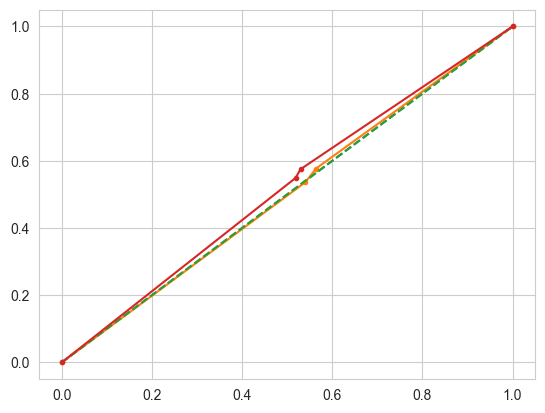

In [171]:
# predict probabilities
probs = reg_dt_model.predict_proba(X_train)
# keep probabilities for the positive outcome only
probs = probs[:, 1]
# calculate AUC
from sklearn.metrics import roc_auc_score
auc = roc_auc_score(y_train, probs)
print('Train_AUC: %.3f' % auc)
# calculate roc curve
from sklearn.metrics import roc_curve
fpr, tpr, thresholds = roc_curve(y_train, probs)
plt.plot([0, 1], [0, 1], linestyle='--')
# plot the roc curve for the model
plt.plot(fpr, tpr, marker='.')

# predict probabilities
probs = reg_dt_model.predict_proba(X_test)
# keep probabilities for the positive outcome only
probs = probs[:, 1]
# calculate AUC
from sklearn.metrics import roc_auc_score
auc = roc_auc_score(y_test, probs)
print('Test_AUC: %.3f' % auc)
# calculate roc curve
from sklearn.metrics import roc_curve
fpr, tpr, thresholds = roc_curve(y_test, probs)
plt.plot([0, 1], [0, 1], linestyle='--')
# plot the roc curve for the model
plt.plot(fpr, tpr, marker='.')
# show the plot
plt.show()

AUC: 0.519


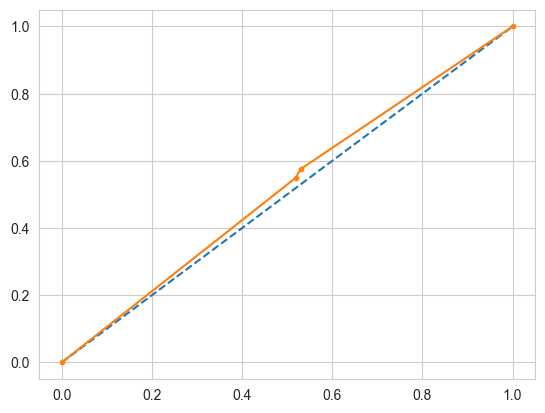

In [172]:
# predict probabilities
probs = reg_dt_model.predict_proba(X_test)
# keep probabilities for the positive outcome only
probs = probs[:, 1]
# calculate AUC
from sklearn.metrics import roc_auc_score
auc = roc_auc_score(y_test, probs)
print('AUC: %.3f' % auc)
# calculate roc curve
from sklearn.metrics import roc_curve
fpr, tpr, thresholds = roc_curve(y_test, probs)
plt.plot([0, 1], [0, 1], linestyle='--')
# plot the roc curve for the model
plt.plot(fpr, tpr, marker='.')
# show the plot
plt.show()

In [173]:
print('Classification Report of the train data:\n\n')
print(classification_report(train_labels, ytrain_predict))

Classification Report of the train data:


              precision    recall  f1-score   support

           0       0.70      0.65      0.68       433
           1       0.74      0.78      0.76       540

    accuracy                           0.72       973
   macro avg       0.72      0.72      0.72       973
weighted avg       0.72      0.72      0.72       973



In [174]:
print('Classification Report of the test data:\n\n')
print(classification_report(test_labels, ytest_predict))

Classification Report of the test data:


              precision    recall  f1-score   support

           0       0.62      0.60      0.61       181
           1       0.70      0.73      0.71       237

    accuracy                           0.67       418
   macro avg       0.66      0.66      0.66       418
weighted avg       0.67      0.67      0.67       418



In [175]:
print('Confusion Matrix of the train data:\n\n')
confusion_matrix(train_labels, ytrain_predict)

Confusion Matrix of the train data:




array([[282, 151],
       [118, 422]], dtype=int64)

In [176]:
print('Confusion Matrix of the test data:\n\n')
confusion_matrix(test_labels, ytest_predict)

Confusion Matrix of the test data:




array([[108,  73],
       [ 65, 172]], dtype=int64)

In [177]:
reg_dt_model.score(X_train,train_labels)

0.723535457348407

In [178]:
reg_dt_model.score(X_test,test_labels)

0.6698564593301436